# Project 2 MLA310
Version 14.11.23

In [1]:
using VMLS, LinearAlgebra, Statistics, Plots, MLDatasets, MAT, Random 
# MLA310.jl contains most Julia-functions that we have designed in the course:
include("./MLA310.jl")
if !@isdefined svdr
    using .MLA310
end

## Clustering and Classification of the MNIST hand-written digits:

[<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/2/27/MnistExamples.png/320px-MnistExamples.png" width=500 height=400 title = "MNIST samples"/>](https://en.wikipedia.org/wiki/MNIST_database)

### You can read about the MNIST dataset here:
* Main web-page about the [MNIST data](http://www.dia.fi.upm.es/~lbaumela/PracRF11/MNIST.html) (maintained by 2018-Turing Award winner [Yann LeCun](https://awards.acm.org/about/2018-turing)).
* [Wikipedia-page of MNIST](https://en.wikipedia.org/wiki/MNIST_database).


### Files are avaialble in the associated Project 2-folder (Canvas/GitHub).
Based on the below exercises, we want you to take an explorative approach to analysis of the MNIST-dataset based on what we have learned so far in MATH310. Use your skills and creativity to gain insights for improved problem solving.

### First some code for reading data & doing visualization

┌ Warning: MNIST.traindata() is deprecated, use `MNIST(split=:train)[:]` instead.
└ @ MLDatasets C:\Users\aarlm\.julia\packages\MLDatasets\mtOdX\src\datasets\vision\mnist.jl:187


┌ Warning: MNIST.testdata() is deprecated, use `MNIST(split=:test)[:]` instead.
└ @ MLDatasets C:\Users\aarlm\.julia\packages\MLDatasets\mtOdX\src\datasets\vision\mnist.jl:195


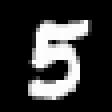

In [2]:
train_x, train_y = MNIST.traindata();
test_x,  test_y  = MNIST.testdata();
p1, p2, m = size(train_x) # p1 x p2 - image size,   n - number of images
~, ~, mte = size(test_x)  # p1 x p2 - image size, nte - number of images
n = p1*p2;                # The number of pixels
ng = maximum(train_y)+1;  # Originally the groups are labelled (1,2,...,9,0)

# We convert the training-data into vectors for clustering (where the labels will be ignored).
Xtrain = convert(Matrix{Float64}, reshape(permutedims(train_x, (3,1,2)), (m, n)));
Xtest  = convert(Matrix{Float64}, reshape(permutedims(test_x, (3,1,2)), (mte, n)));

Gtrain = train_y;  Gtrain[Gtrain.==0].=10  # The training labels (0's are re-labelled as 10)
Gtest  = test_y;   Gtest[Gtest.==0]  .=10  # The test labels

I      = Int.(eye(ng)); # evt =eye(ng); # or I = 1.0*Matrix(LinearAlgebra.I, ng, ng); # Identity matrix for generating the one-hot (dummy) encoding of the training- and test labels.
Ytrain = I[Gtrain,:]; Ytest  = I[Gtest,:];    # One-hot (dummy) encoding of the training- and test labels.
ngtrain= sum(Ytrain, dims = 1);   ngtest = sum(Ytest, dims = 1); # The number of samples in each group.

# Display an image to check that things work:
using Images
Gray.(train_x[:,:,29488]') 

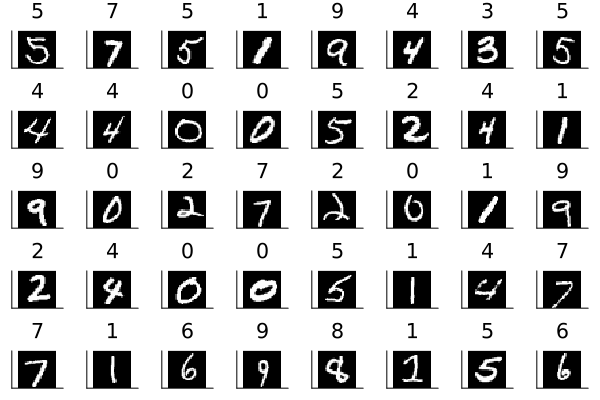

In [5]:
# ---------------------------------------------------------
# For collecting and plotting a ramdom sample of images from the MNIST-dataset
plot_array = []
sams = 40; idsi = sort(randperm(m)[1:sams])

for k in 1:length(idsi)
    #push!(plot_array, plot(Gray.(reshape(Xtrain[idsi[k],:]/255,(28,28)))', axis = nothing))
    push!(plot_array, plot(Gray.(reshape(Xtrain[idsi[k],:],(28,28)))', axis = nothing))
end
cla = reshape(string.(rem.(Gtrain[idsi],ng)), 1,sams) # Class labels
display(plot(plot_array..., layout =(5,8), title = cla))

## Principal component analysis (PCA) and classification with the MNIST dataset
The MNIST-dataset has 10 groups (the digits 0-9). Focus on the __training data__ unless otherwise specified.

### Exercise 1:
* a) For each (digit-)group: Do a PCA by SVD and monitor the percent of explained variance as a function of the number of included principal components. How many components must be included to explain at least 90% of the variance within each group?
* b) For each of the (digit-)groups: Visualize the first 10 PCA-loadings (i.e. the 784-dimensional right singular vectors) as images & comment on what you see.
* c) For each (digit-)group: Visualize (as images) some samples before and after projection/compression onto the sub-space explaining 90% of the total variance, and compare to the original sample-images.

In [6]:
pcs   = 100;        # We will calculate 'pcs' principal components for each group.
nc090 = zeros(ng);  # For storing the number of comps. required to explain 90% variance for each group 
EVS   = zeros(pcs,ng); # For storing the

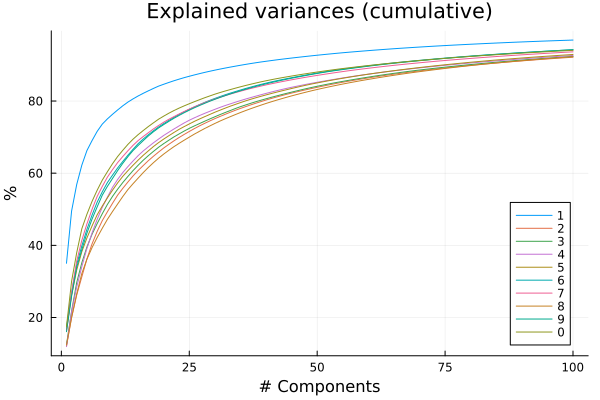

10-element Vector{Int64}:
 36
 81
 80
 76
 75
 62
 66
 82
 62
 62

In [7]:
# 1a)

# The explained variances and the requested number of components:
for g = 1:ng
    ~, σ², sσ², ~, ~, ~, ~ = my_PCA(Xtrain[Gtrain.==g, :]; mc=pcs);
    EVS[:,g] = cumsum(σ²/sσ²)  # The explained PCA-variances (cumulative) for group g:
    nc090[g] = findfirst(EVS[:,g] .>= 0.90);
end

labs = reshape(string.(rem.(1:ng,ng)), 1,ng) # Class labels (1,2,3,...,9,0) )
display(plot(100*EVS, label = labs, legend=:bottomright, title = "Explained variances (cumulative)", xlabel = "# Components", ylabel = "%"))

nc090 = Int.(nc090) # The number of inluded components

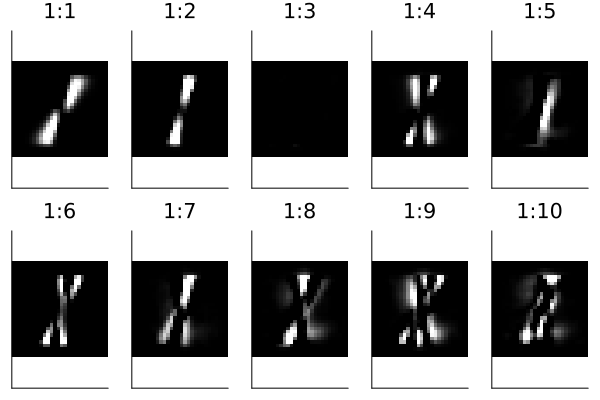

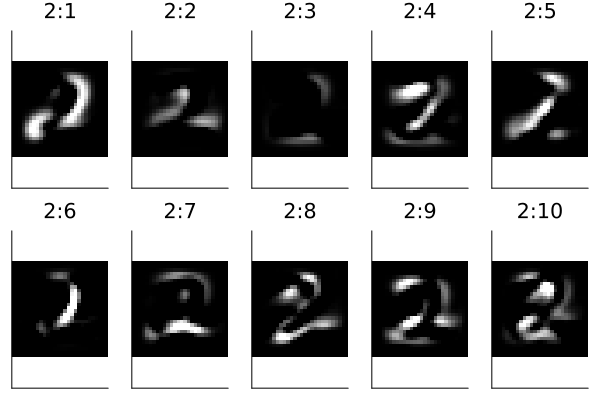

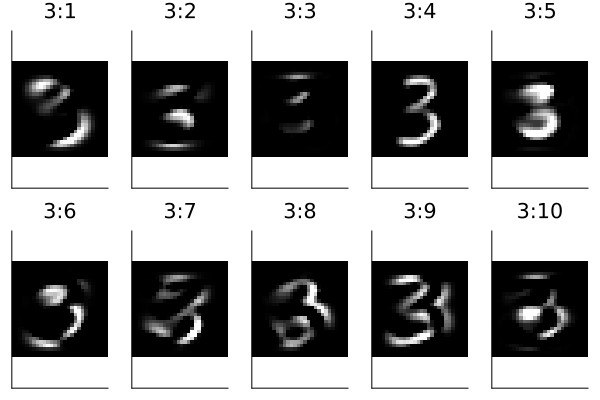

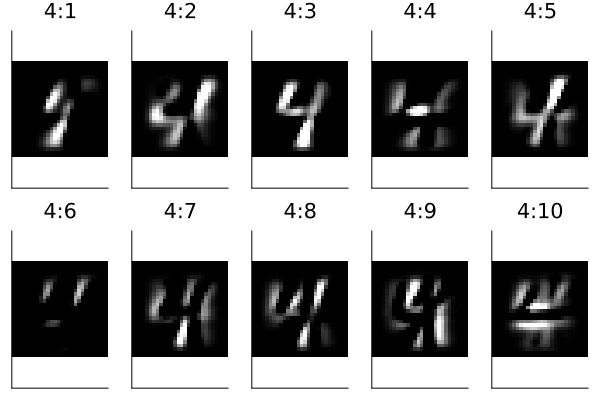

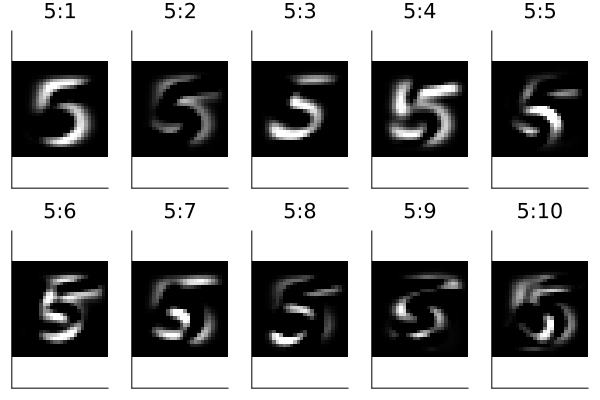

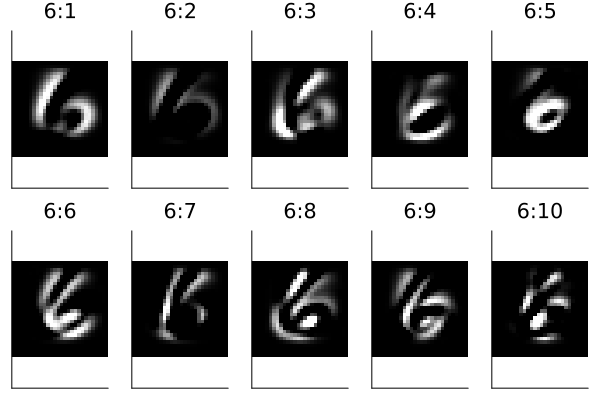

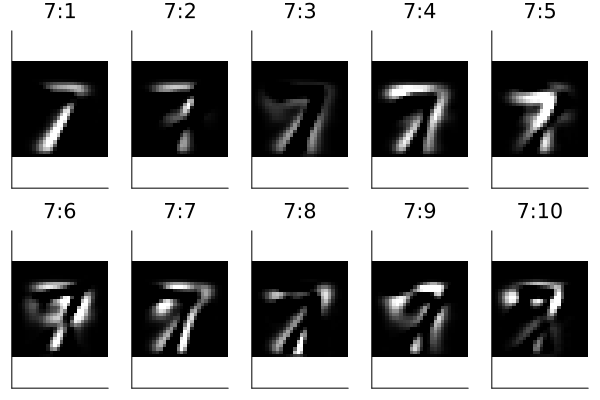

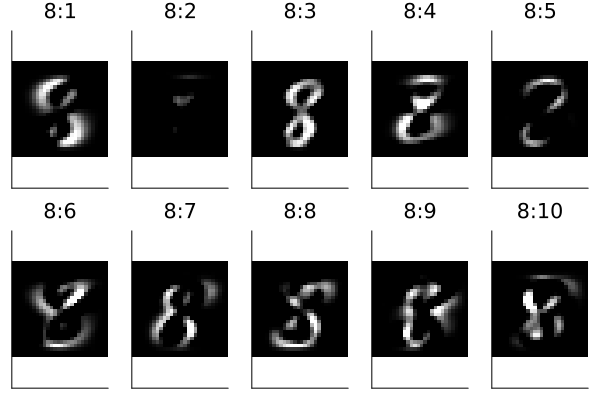

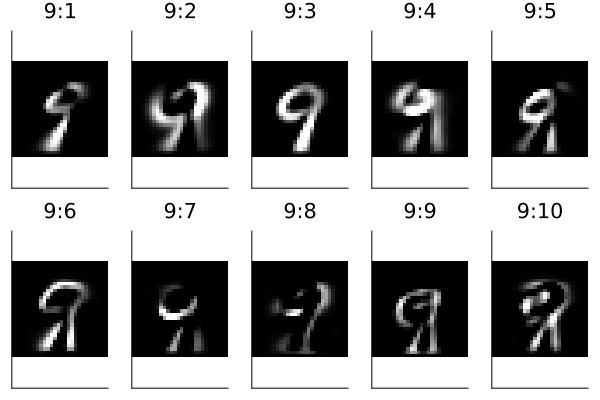

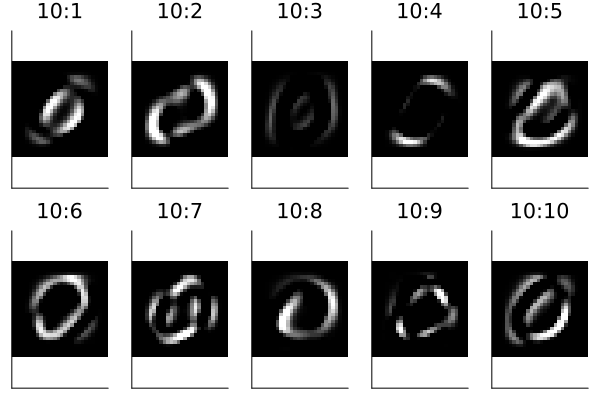

In [8]:
# 1b) 
npc = 10;
for g = 1:10
    plot_s = [] 
    ~, ~, ~, ~, V, ~, ~ = my_PCA(Xtrain[Gtrain.==g,:]; mc = npc);
    for k = 1:npc
        push!(plot_s, plot(Gray.(reshape(10*V[:,k],(28,28)))', axis = nothing))
    end
    labs = reshape((string(g)*':').*string.(1:10),1,npc) # Class labels
    display(plot(plot_s..., layout = (2,5), title = labs))
end


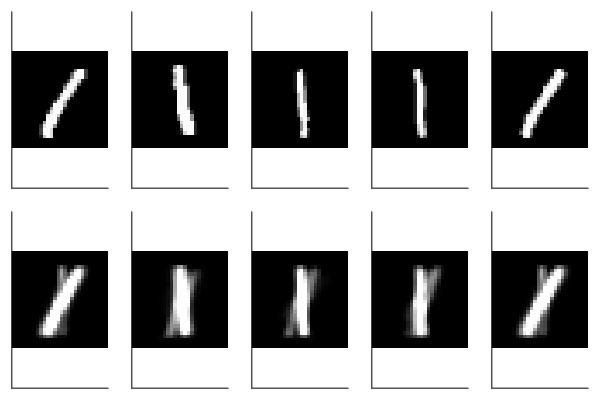

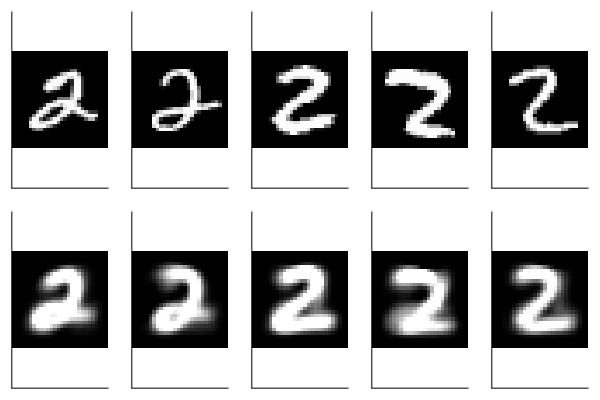

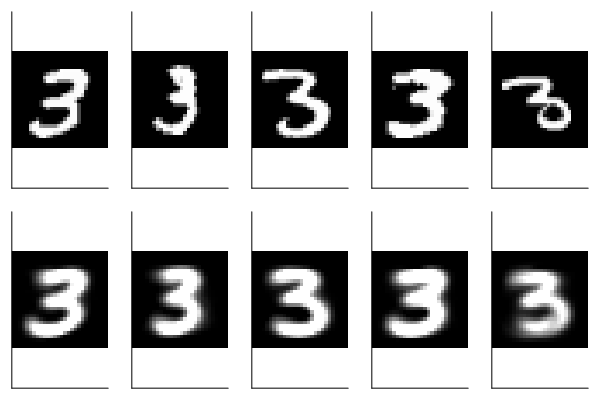

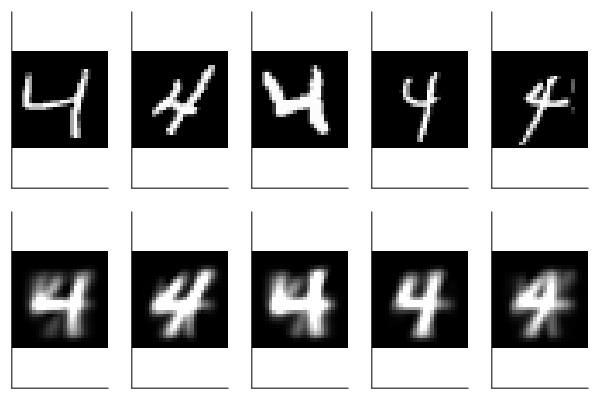

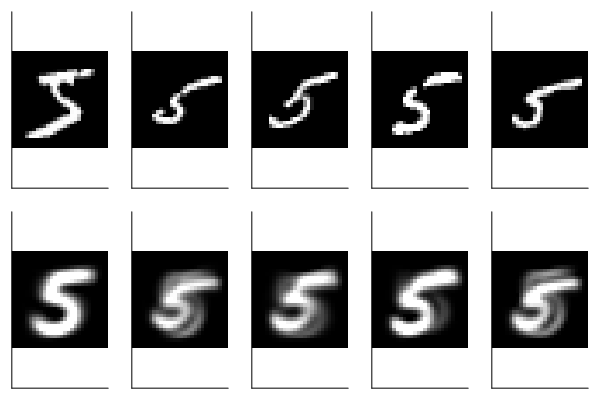

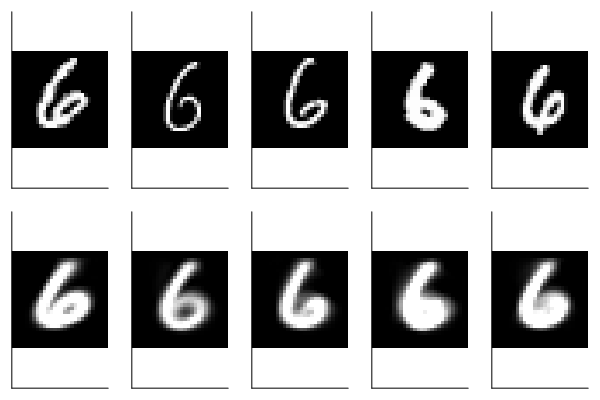

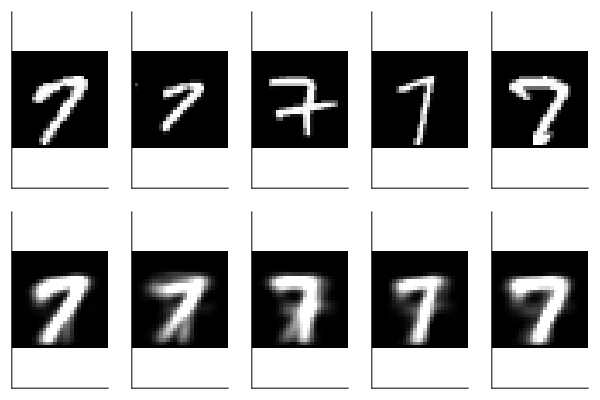

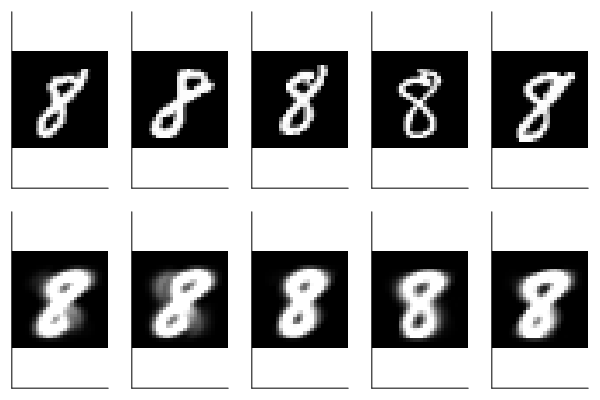

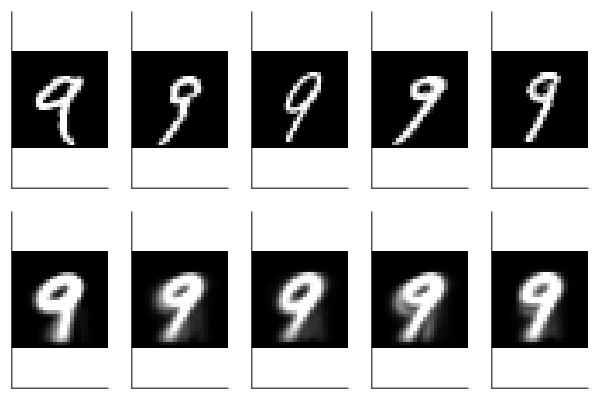

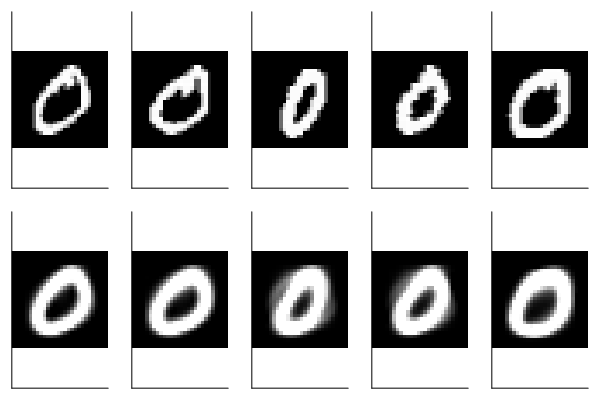

In [9]:
# 1c)
npc = 10;
for g = 1:10
    plot_s = []
    T, σ², sσ², x̄, V, σ, U = my_PCA(Xtrain[Gtrain.==g,:]; mc = npc);
    ids = 1:5; # randperm(ngtrain[g])[1:5];
    Xg = Xtrain[Gtrain.==g,:][ids,:]
    for k = 1:5
       push!(plot_s,  plot(Gray.(reshape(Xg[[k],:],(28,28)))',  axis = nothing)) # Show samples before projection
    end
   for k = 1:5
       push!(plot_s,  plot(Gray.(reshape(x̄ .+ (Xg[[k],:]*V)*V',(28,28)))',  axis = nothing)) # Show samples after projection
    end
display(plot(plot_s..., layout = (2,5)))
end


## Exercise 2
* a) Extend the function PCRk(X, y; k = 1) to a new function PCRYk(X, Y; k = 1) accepting multiple responses as a (m x q)-matrix Y that calculates and returns the regression coeffs for all q responses.
* b) Use PCRYk to make a regression-based classifier by including 30 principal components. Calculate the % of correctly classified samples and confusion matrices for both the training- and the test samples.

In [60]:
# 2a)
"""
    PCRYk(X, Y)

Principal Component Regression with multiple responses

# Arguments
- `X`: data-matrix
- `Y`: matrix of response vectors
- `k=1`: number of principal components

# Returns
- `β₀`: the constant terms (1×k vector) of the PCR-models for up to k components.
- `Β` : the PC regression coeffs (m×k matrix) for the X-data for up to k components.
"""
function PCRYk(X, Y; k = 1)
m,n = size(X)
q = size(Y,2)    
mc  = min(k, min(n,m)-1) # Make sure that the maximum number of components is not too large.
x̄   = mean(X, dims=1) # - row vector of the X-column mean values.
Ȳ   = mean(Y, dims=1) # - the mean of the response values y.
Y₀  = Y.- Ȳ;          # - the centered response vector.
U, σ, V = svd(X.-x̄)   # - SVD of the centered X-data to find the principal components.
U = U[:,1:k]; σ = σ[1:k]; V = V[:,1:k]; # Restriction to the first mc components.
Q = (σ.^(-1).*(U'*Y₀));   # the regression coeffs for the PCA-scores.

Β = Vector(undef, q); β₀ = Vector(undef, q)     

for j = 1:q
Β[j] = cumsum(V.*Q[:, j]', dims=2);   # the PCR-regression coeffs for the X-data based on up to k components
β₀[j] = Ȳ[j] .- x̄*Β[j];# the correspondning constant terms for the PCR-models.
end
         
return β₀, Β;
end

PCRYk

In [14]:
# 2b) 
npc = 30;
β₀, Β = PCRYk(Xtrain, Ytrain; k = npc);

# The regression models for the PCR-models including exactly 30 components:
BB  = hcat([Β[g][:,npc]  for g = 1:10] ...);
β₀₀ = hcat([β₀[g][:,npc] for g = 1:10] ...);

In [15]:
# To find the entry of maximum value in each row of a matrix (M):
row_argmax(M) = [argmax(M[i,:]) for i = 1:size(M,1)]; #row_argmax(M) = getindex.(argmax(M, dims=2),2);

In [16]:
Yhat0 = Xtrain*BB .+ β₀₀;       # The fitted values predicting Ytrain
Ghat0 = row_argmax(Yhat0);               # The predictions of Gtrain
pcctrain = sum(Ghat0.== Gtrain , dims=1)/m # The % of correctly classified training samples

1-element Vector{Float64}:
 0.8193333333333334

In [17]:
Yhate = Xtest*BB.+ β₀₀;      # The test set predictions (of Ytest)
Ghate = row_argmax(Yhate);            # The predictions of Gtest
pcctest = sum(Ghate.== Gtest, dims=1)/mte # The % of correctly classified test samples

1-element Vector{Float64}:
 0.8301

In [18]:
# Confusion matrix function:
function confmat(G, Gpred)
ng = maximum(G); CM = zeros(Int,ng,ng);
for k = 1:length(G)
  CM[G[k], Gpred[k]] += 1;
end
return CM
end

confmat (generic function with 1 method)

In [19]:
# Confusion matrix - training data predictions:
CMtrain = confmat(Gtrain, Ghat0)

10×10 Matrix{Int64}:
 6557    47     8     5    22    13    14    70     5     1
  382  4586   117   136     6   229   221   152    51    78
  223   269  4881    26   166    97   180   132    97    60
  145    48    10  4967    17   122    58    84   378    13
  225    39   726   212  3087   307    97   267    78   383
  128    33     4    58    73  5474     4    20     1   123
  302    73    31   137     8    10  5496    20   119    69
  596   118   283    90   171    81    62  4267   123    60
  161    50   115   478    73    24   589    70  4289   100
    7    29    37    20    32   158    24    54     6  5556

In [20]:
# Confusion matrix - test data predictions:
CMtest = confmat(Gtest, Ghate)

10×10 Matrix{Int64}:
 1102    7    2    1    1    5    3   14    0    0
   76  795   23   19    0   27   31   37    9   15
   29   33  830    1   28   14   33   21   13    8
   31    4    1  841    5   19    4   12   63    2
   31    5  118   34  524   48   31   48   13   40
   14    3    1   11   14  885    1    2    0   27
   64   21    4   18    0    4  886    4   20    7
   61   14   41   14   23   27   21  747   13   13
   16   10   17   92   14    5   73   11  753   18
    0    2    3    1   10   19    2    5    0  938

##  $k$-means clustering within each group of the training-data
### Exercise 3:
__For each (digit-)group:__ Choose $k = 3$ and do $k$-means clustering. Visualize (as images) the cluster centers and inspect PCA-scoreplots (scatterplots) based on your work in Exercise 1 (consider colouring of the samples according to the cluster labelling). 

In [3]:
k = 3 
z_n = zeros(n, k, ng) # cluster
labels = zeros(length(Gtrain))

for g = 1:ng
    g_idx = findall(x -> x == g, Gtrain)
    X_g = eachrow(Xtrain[g_idx, :])
    c_g, z_g, Js_g = kmeans_(X_g, k)
    z_n[:, :, g] = hcat(z_g...)
    labels[g_idx] = c_g
end

Iteration 1: Jclust = 

22.259883570492487.


Iteration 2: Jclust = 14.548731457237142.


Iteration 3: Jclust = 14.005370206226694.


Iteration 4: Jclust = 13.846712026316752.


Iteration 5: Jclust = 13.773676505218813.


Iteration 6: Jclust = 13.728580545835781.


Iteration 7: Jclust = 13.69487117283183.


Iteration 8: Jclust = 13.667071276032072.


Iteration 9: Jclust = 13.649695885866672.


Iteration 10: Jclust = 13.631528189221097.


Iteration 11: Jclust = 13.61887663525777.


Iteration 12: Jclust = 13.611786131370264.


Iteration 13: Jclust = 13.60602591733928.


Iteration 14: Jclust = 13.600933555832679.


Iteration 15: Jclust = 13.597466163211552.


Iteration 16: Jclust = 13.594714150470915.


Iteration 17: Jclust = 13.591800324586467.


Iteration 18: Jclust = 13.589969721835914.


Iteration 19: Jclust = 13.588737065363958.


Iteration 20: Jclust = 13.587840355614642.


Iteration 21: Jclust = 13.5872860615133.


Iteration 22: Jclust = 13.586956186014596.


Iteration 23: Jclust = 13.586654900871077.


Iteration 24: Jclust = 13.586397688252033.


Iteration 25: Jclust = 13.586334376953502.


Iteration 1: Jclust = 50.41376399794101.


Iteration 2: Jclust = 45.74754925575481.


Iteration 3: Jclust = 45.07935510560136.


Iteration 4: Jclust = 44.88111626600488.


Iteration 5: Jclust = 44.73662019022282.


Iteration 6: Jclust = 44.60947343264049.


Iteration 7: Jclust = 44.496043034443396.


Iteration 8: Jclust = 44.40732702303258.


Iteration 9: Jclust = 44.346374454103426.


Iteration 10: Jclust = 44.29204638697401.


Iteration 11: Jclust = 44.24769134591867.


Iteration 12: Jclust = 44.216973345935116.


Iteration 13: Jclust = 44.18691319862974.


Iteration 14: Jclust = 44.16613654330527.


Iteration 15: Jclust = 44.15041191579694.


Iteration 16: Jclust = 44.13912322407397.


Iteration 17: Jclust = 44.13183440292105.


Iteration 18: Jclust = 44.12445999222876.


Iteration 19: Jclust = 44.121861592804784.


Iteration 20: Jclust = 44.119920370036866.


Iteration 21: Jclust = 44.118201645826645.


Iteration 22: Jclust = 44.11656244070772.


Iteration 23: Jclust = 44.11552431396702.


Iteration 24: Jclust = 44.114890912870656.


Iteration 25: Jclust = 44.11436148367308.


Iteration 26: Jclust = 44.11385492322935.


Iteration 27: Jclust = 44.11361160486859.


Iteration 1: Jclust = 44.731961339718254.
Iteration 2: Jclust = 40.37003749449433.


Iteration 3: Jclust = 38.89478770181308.


Iteration 4: Jclust = 38.79244575194913.
Iteration 5: Jclust = 38.77739846047889.


Iteration 6: Jclust = 38.77309560696312.
Iteration 7: Jclust = 38.771626927175895.


Iteration 8: Jclust = 38.77075249647643.
Iteration 9: Jclust = 38.770221950696026.


Iteration 10: Jclust = 38.769712105221316.
Iteration 11: Jclust = 38.769221366067086.


Iteration 12: Jclust = 38.76886405057131.


Iteration 1: Jclust = 40.639015924299.
Iteration 2: Jclust = 37.79238619003854.


Iteration 3: Jclust = 37.12682102599854.
Iteration 4: Jclust = 36.6629549848436.


Iteration 5: Jclust = 35.91447040089798.
Iteration 6: Jclust = 35.30425728409968.


Iteration 7: Jclust = 35.17526778792628.
Iteration 8: Jclust = 35.130653024011536.


Iteration 9: Jclust = 35.10116018608695.
Iteration 10: Jclust = 35.07766740092318.


Iteration 11: Jclust = 35.062723006669756.
Iteration 12: Jclust = 35.05235709579452.


Iteration 13: Jclust = 35.04470739224195.
Iteration 14: Jclust = 35.03942523109916.


Iteration 15: Jclust = 35.036398976478864.
Iteration 16: Jclust = 35.033393867116.


Iteration 17: Jclust = 35.03180114691035.
Iteration 18: Jclust = 35.030552160654295.


Iteration 19: Jclust = 35.02971975067513.
Iteration 20: Jclust = 35.02922933638424.


Iteration 21: Jclust = 35.02856044633741.
Iteration 22: Jclust = 35.02799993384734.


Iteration 23: Jclust = 35.02708590915566.
Iteration 24: Jclust = 35.02560911277055.


Iteration 25: Jclust = 35.02456050036262.
Iteration 26: Jclust = 35.0235550961495.


Iteration 27: Jclust = 35.0228970666505.
Iteration 28: Jclust = 35.02235795247707.


Iteration 29: Jclust = 35.02196693624666.
Iteration 30: Jclust = 35.021657516152786

.
Iteration 1: Jclust = 47.11743732548331.
Iteration 2: Jclust = 41.4784053707336.


Iteration 3: Jclust = 39.93404512649274.
Iteration 4: Jclust = 39.13425354901905.


Iteration 5: Jclust = 38.90168704868555.
Iteration 6: Jclust = 38.80556723035317.


Iteration 7: Jclust = 38.76524472652187.
Iteration 8: Jclust = 38.74720569711805.


Iteration 9: Jclust = 38.74055688264118.
Iteration 10: Jclust = 38.737619192890314.


Iteration 11: Jclust = 38.73665728079995.
Iteration 12: Jclust = 38.735699994769504.


Iteration 13: Jclust = 38.734988139574384.
Iteration 14: Jclust = 38.734559593769276.


Iteration 15: Jclust = 38.73433907746424.


Iteration 1: Jclust = 42.6307239516704.
Iteration 2: Jclust = 35.50244301027734.


Iteration 3: Jclust = 35.30427301091293.
Iteration 4: Jclust = 35.25113812027533.


Iteration 5: Jclust = 35.22378342416087.
Iteration 6: Jclust = 35.200306279602394.


Iteration 7: Jclust = 35.17775105181562.
Iteration 8: Jclust = 35.1586390775658.


Iteration 9: Jclust = 35.13861722423458.
Iteration 10: Jclust = 35.118457448237464.


Iteration 11: Jclust = 35.1002521967631.
Iteration 12: Jclust = 35.077607913820025.


Iteration 13: Jclust = 35.05183630908144.
Iteration 14: Jclust = 35.02436393898685.


Iteration 15: Jclust = 34.9920551073016.
Iteration 16: Jclust = 34.958340542041.


Iteration 17: Jclust = 34.92421854574221.
Iteration 18: Jclust = 34.88817874202907.


Iteration 19: Jclust = 34.84835143412769.
Iteration 20: Jclust = 34.81891560903064.


Iteration 21: Jclust = 34.7972217565699.
Iteration 22: Jclust = 34.78146896468481.


Iteration 23: Jclust = 34.77059650144644.
Iteration 24: Jclust = 34.76126387137101.


Iteration 25: Jclust = 34.75631287150425.
Iteration 26: Jclust = 34.75244785772265.


Iteration 27: Jclust = 34.750899246316976.
Iteration 28: Jclust = 34.750513437325964.


Iteration 29: Jclust = 34.75037798909283.


Iteration 1: Jclust = 37.21143018348862.
Iteration 2: Jclust = 31.78910144979162.


Iteration 3: Jclust = 31.019760383555916.
Iteration 4: Jclust = 30.739576173678984.


Iteration 5: Jclust = 30.642123641074665.
Iteration 6: Jclust = 30.6078638955038.


Iteration 7: Jclust = 30.593485731049892.
Iteration 8: Jclust = 30.58447284230174.


Iteration 9: Jclust = 30.579206973021545.
Iteration 10: Jclust = 30.575514389350147.


Iteration 11: Jclust = 30.57279120076131.
Iteration 12: Jclust = 30.570667537486347.


Iteration 13: Jclust = 30.56918181279839.
Iteration 14: Jclust = 30.568493300517044.


Iteration 15: Jclust = 30.56809251738239.
Iteration 16: Jclust = 30.56762874687014.


Iteration 17: Jclust = 30.567088711501007.
Iteration 18: Jclust = 30.566510249136332.


Iteration 19: Jclust = 30.565801539883836.
Iteration 20: Jclust = 30.56529985854251.


Iteration 21: Jclust = 30.564642606901817.
Iteration 22: Jclust = 30.563770175657183.


Iteration 23: Jclust = 30.56310671951942.
Iteration 24: Jclust = 30.56250151566795.


Iteration 25: Jclust = 30.56200567785365.
Iteration 26: Jclust = 30.561706591660194.


Iteration 1: Jclust = 45.327154266972855.


Iteration 2: Jclust = 40.66807323079108.


Iteration 3: Jclust = 39.997916453418405.


Iteration 4: Jclust = 39.91166141796463.
Iteration 5: Jclust = 39.884184825704146.


Iteration 6: Jclust = 39.86865918014081.


Iteration 7: Jclust = 39.86051776167782.


Iteration 8: Jclust = 39.85238715681724.
Iteration 9: Jclust = 39.842748005330705.


Iteration 10: Jclust = 39.8272662050454.


Iteration 11: Jclust = 39.80302130191875.


Iteration 12: Jclust = 39.76652324552658.
Iteration 13: Jclust = 39.72461482498365.


Iteration 14: Jclust = 39.67996065669166.


Iteration 15: Jclust = 39.63096318073313.


Iteration 16: Jclust = 39.59037894108489.


Iteration 17: Jclust = 39.56007858636079.


Iteration 18: Jclust = 39.53928510953307.


Iteration 19: Jclust = 39.527909719403404.


Iteration 20: Jclust = 39.52074375364584.


Iteration 21: Jclust = 39.51725703768197.


Iteration 22: Jclust = 39.51480684236235.
Iteration 23: Jclust = 39.51214481624266.


Iteration 24: Jclust = 39.510095480219086.


Iteration 25: Jclust = 39.50901016445985.


Iteration 26: Jclust = 39.50858048823543.


Iteration 27: Jclust = 39.50821815402385.


Iteration 1: Jclust = 38.13305840459291.
Iteration 2: Jclust = 32.98317918768899.


Iteration 3: Jclust = 32.50098952961413.
Iteration 4: Jclust = 32.05254013703356.


Iteration 5: Jclust = 31.715269333192936.
Iteration 6: Jclust = 31.56508811260649.


Iteration 7: Jclust = 31.506198902068814.
Iteration 8: Jclust = 31.473538835140626.


Iteration 9: Jclust = 31.455699168700278.
Iteration 10: Jclust = 31.44652763421142.


Iteration 11: Jclust = 31.44282119960996.
Iteration 12: Jclust = 31.441371803611954.


Iteration 13: Jclust = 31.440691285233346.
Iteration 14: Jclust = 31.440356208985648.


Iteration 15: Jclust = 31.440089803401857.


Iteration 1: Jclust = 49.52145553268746.


Iteration 2: Jclust = 43.39724120240054.


Iteration 3: Jclust = 41.018821024718186.


Iteration 4: Jclust = 40.730176599110386.


Iteration 5: Jclust = 40.636229581358975.


Iteration 6: Jclust = 40.56487065119698.


Iteration 7: Jclust = 40.48971028274077.


Iteration 8: Jclust = 40.41315393068059.


Iteration 9: Jclust = 40.32505132998582.


Iteration 10: Jclust = 40.23857317015505.


Iteration 11: Jclust = 40.14496480680577.


Iteration 12: Jclust = 40.070402882328835.


Iteration 13: Jclust = 40.00241150079156.


Iteration 14: Jclust = 39.952142782405154.
Iteration 15: Jclust = 39.92652106234712.


Iteration 16: Jclust = 39.90047217413341.


Iteration 17: Jclust = 39.87105773339102.
Iteration 18: Jclust = 39.849355882701815.


Iteration 19: Jclust = 39.831821959755864.


Iteration 20: Jclust = 39.81997213347156.


Iteration 21: Jclust = 39.808691282796964

.
Iteration 22: Jclust = 39.79799394654218.


Iteration 23: Jclust = 39.789441533933086.
Iteration 24: Jclust = 39.78020705420614.


Iteration 25: Jclust = 39.77226139813862.


Iteration 26: Jclust = 39.76705078923208.


Iteration 27: Jclust = 39.76342989801785.


Iteration 28: Jclust = 39.76141736199318.


Iteration 29: Jclust = 39.7602733153157.
Iteration 30: Jclust = 39.75989656989584.


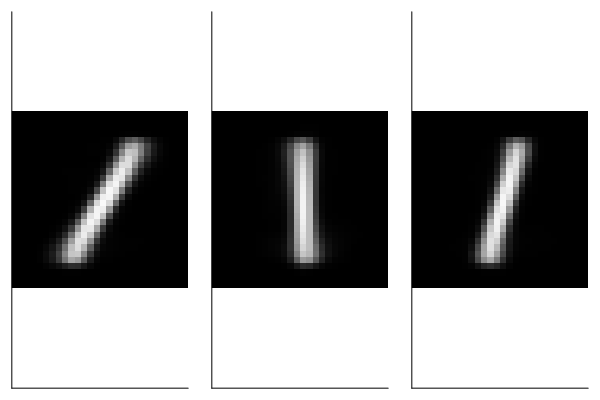

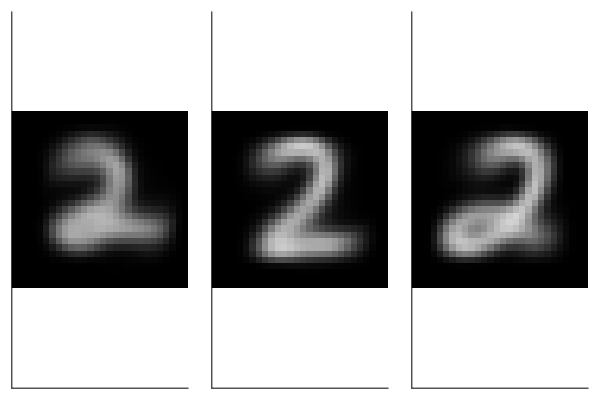

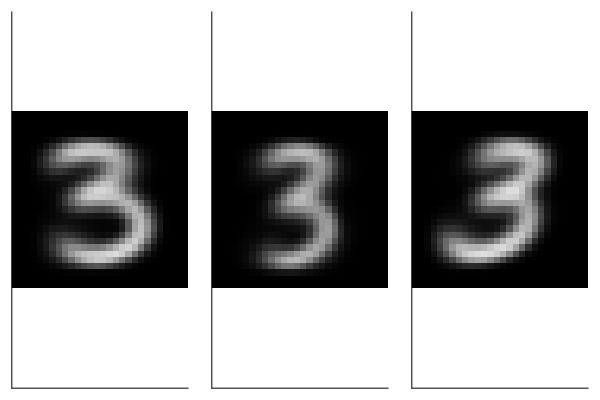

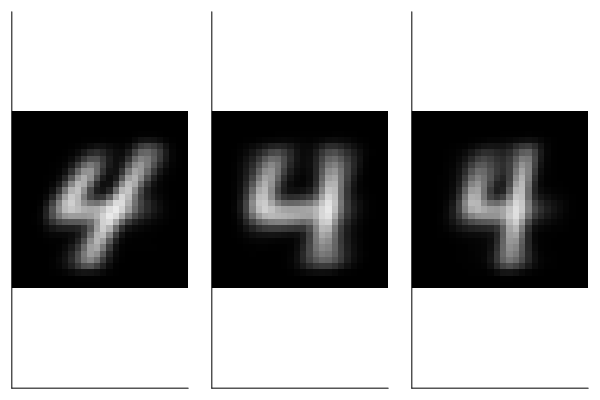

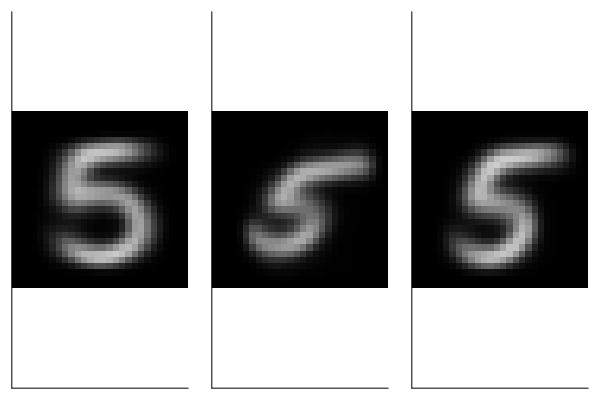

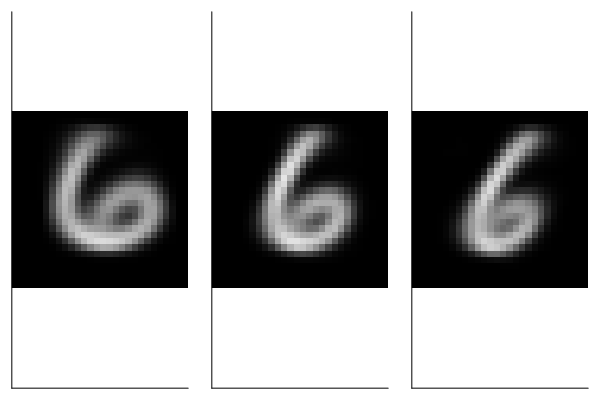

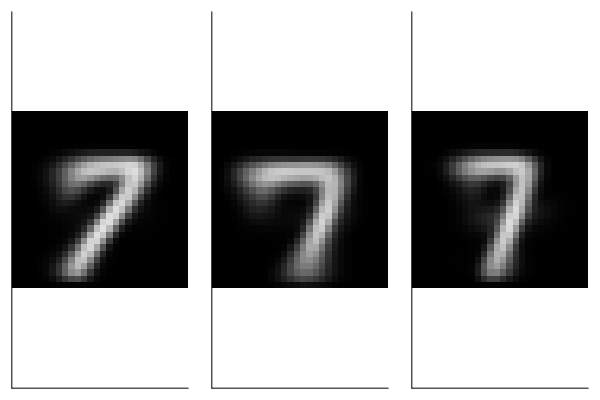

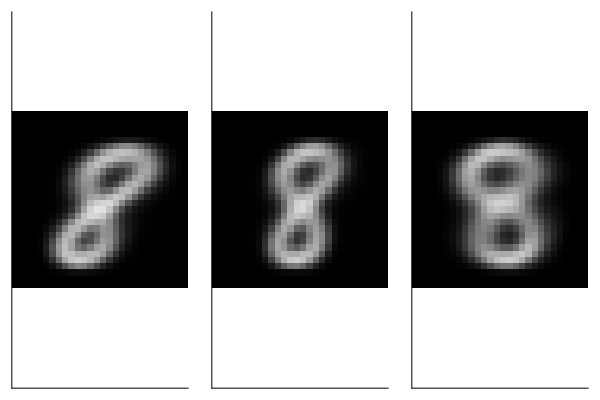

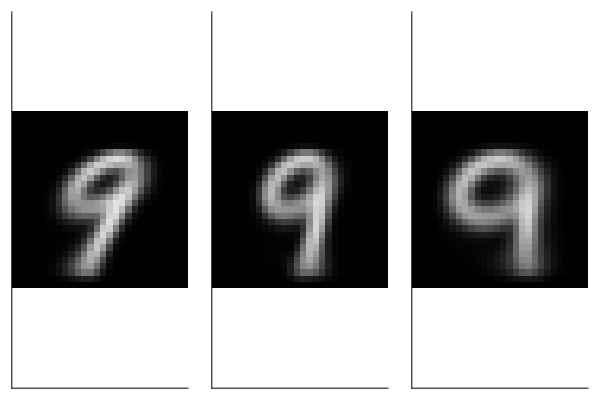

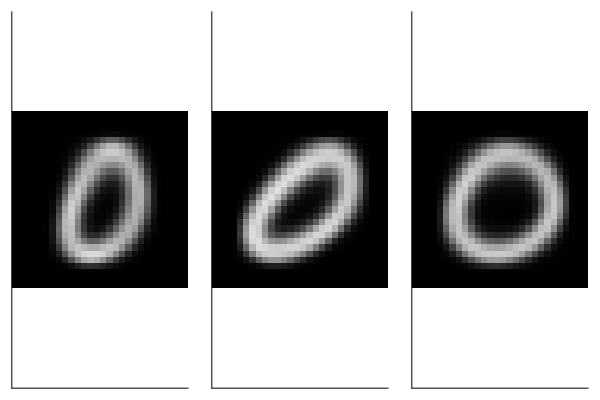

In [7]:
for g = 1:ng
    z_plot = []
    for i=1:3
        push!(z_plot, plot(Gray.(reshape(z_n[:, i, g],(28,28)))', axis = nothing))
    end
    # display(plot(z_plot..., layout = (1,3), title = "Group "*string(g)))
    display(plot(z_plot..., layout = (1,3)))
end

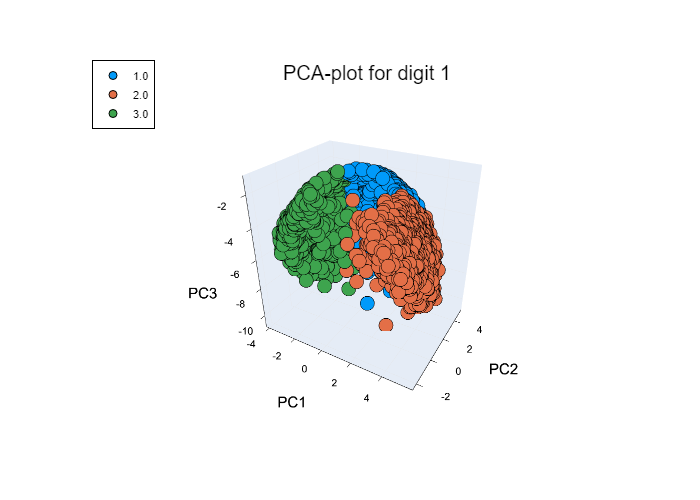

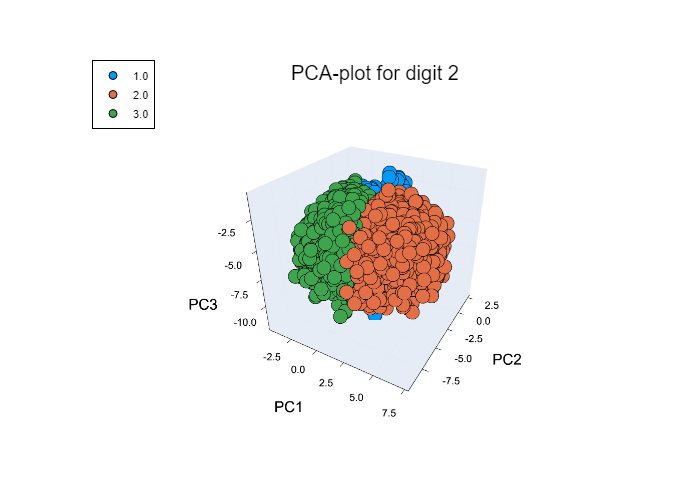

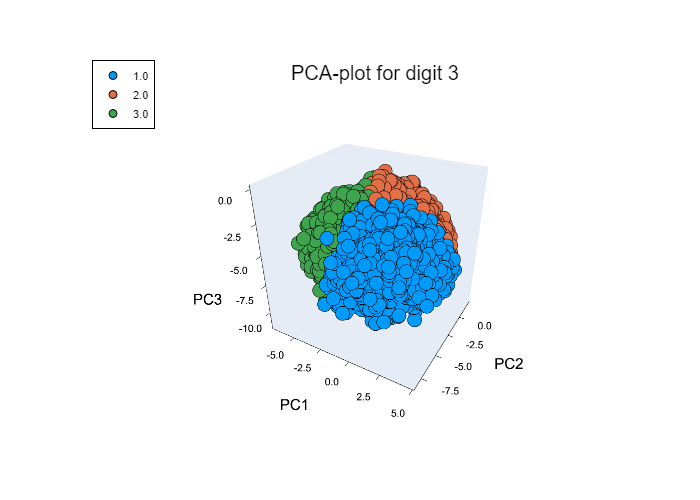

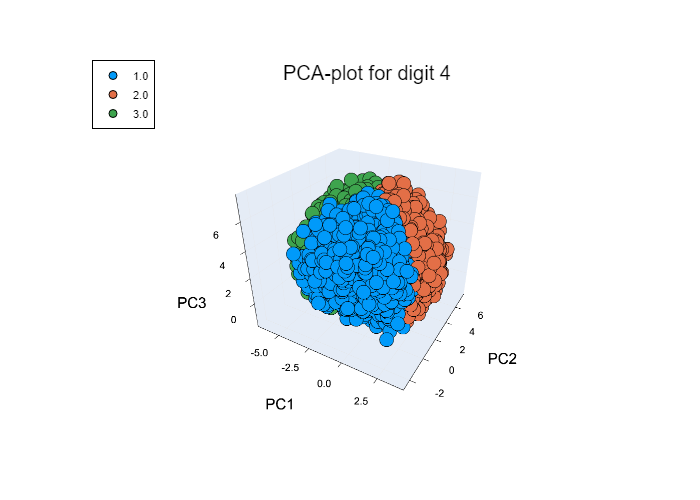

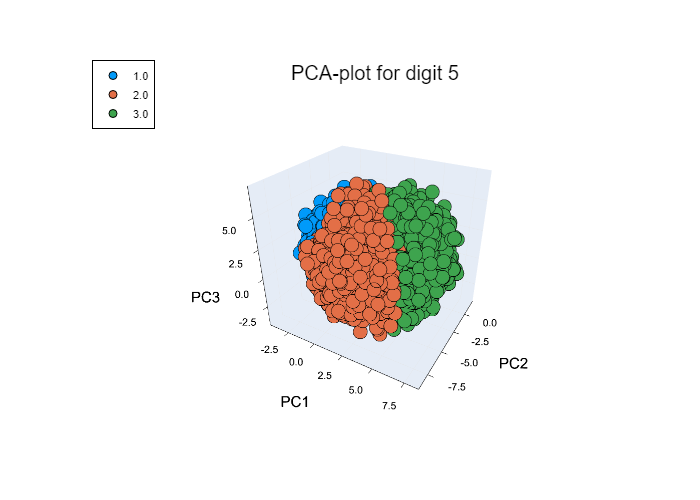

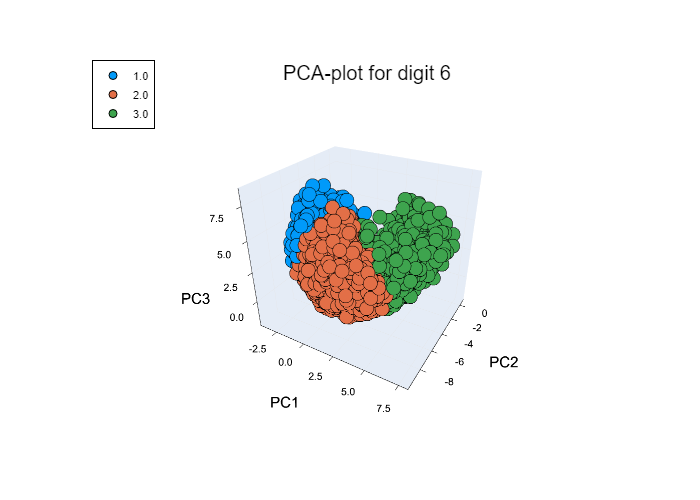

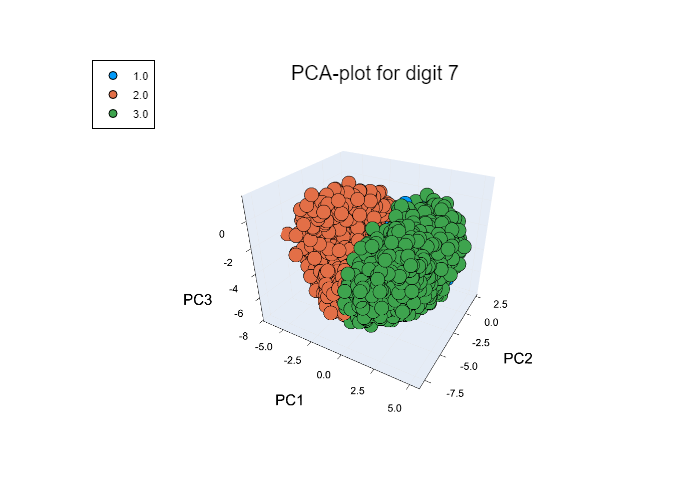

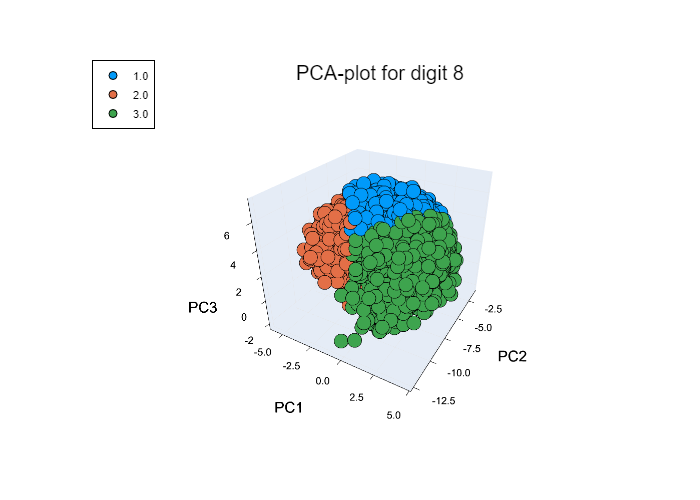

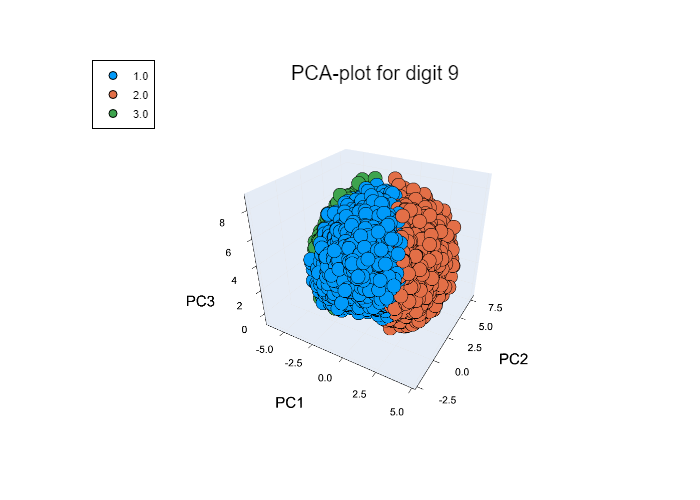

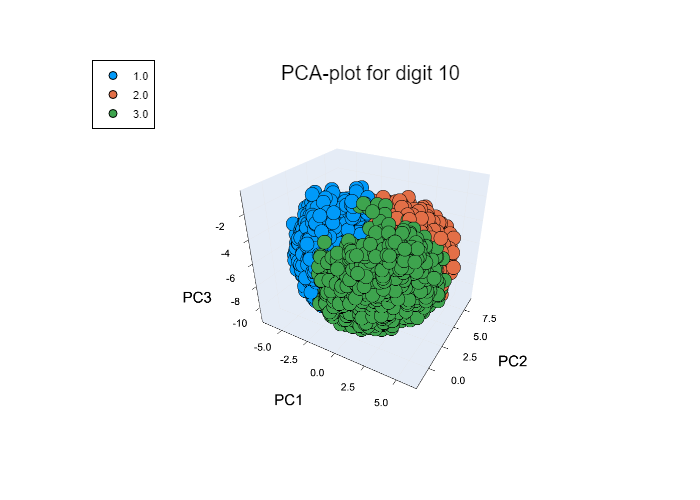

In [5]:
pcs = 3
plotlyjs()
for g = 1:ng
    g_idx = findall(x -> x == g, Gtrain)
    X_g = Xtrain[Gtrain.==g, :]
    ~, ~, ~, ~, V, ~, ~ = my_PCA(X_g; mc=3);
    X_fit = X_g*V
    c_label = labels[g_idx]
    PCA_plot = scatter(X_fit[:, 1], X_fit[:, 2], X_fit[:, 3], group = c_label, legend=:topleft, title = "PCA-plot for digit "*string(g))
    plot!(PCA_plot, xlabel="PC1", ylabel="PC2", zlabel="PC3")
    display(PCA_plot)
end

### Exercise 4

#### Load and prepare data

In [2]:
train_x, train_y = MNIST.traindata();
test_x,  test_y  = MNIST.testdata();
p1, p2, m = size(train_x) # p1 x p2 - image size,   n - number of images
~, ~, mte = size(test_x)  # p1 x p2 - image size, nte - number of images
n = p1*p2;                # The number of pixels
ng = maximum(train_y)+1;  # Originally the groups are labelled (1,2,...,9,0)

# We convert the training-data into vectors for clustering (where the labels will be ignored).
Xtrain = convert(Matrix{Float64}, reshape(permutedims(train_x, (3,1,2)), (m, n)));
Xtest  = convert(Matrix{Float64}, reshape(permutedims(test_x, (3,1,2)), (mte, n)));

Gtrain = train_y;  Gtrain[Gtrain.==0].=10  # The training labels (0's are re-labelled as 10)
Gtest  = test_y;   Gtest[Gtest.==0]  .=10  # The test labels

I      = Int.(eye(ng)); # evt =eye(ng); # or I = 1.0*Matrix(LinearAlgebra.I, ng, ng); # Identity matrix for generating the one-hot (dummy) encoding of the training- and test labels.
Ytrain = I[Gtrain,:]; Ytest  = I[Gtest,:];    # One-hot (dummy) encoding of the training- and test labels.
ngtrain= sum(Ytrain, dims = 1);   ngtest = sum(Ytest, dims = 1); # The number of samples in each group.

# Display an image to check that things work:
#using Images
#Gray.(train_x[:,:,29488]') 

┌ Warning: MNIST.traindata() is deprecated, use `MNIST(split=:train)[:]` instead.
└ @ MLDatasets C:\Users\aarlm\.julia\packages\MLDatasets\mtOdX\src\datasets\vision\mnist.jl:187
┌ Warning: MNIST.testdata() is deprecated, use `MNIST(split=:test)[:]` instead.
└ @ MLDatasets C:\Users\aarlm\.julia\packages\MLDatasets\mtOdX\src\datasets\vision\mnist.jl:195


1×10 Matrix{Int64}:
 1135  1032  1010  982  892  958  1028  974  1009  980

### Define the multi-response version of RR/TR with fast LooCV

In [3]:
#using LinearAlgebra, Statistics, VMLS
#include("svdr.jl");

function TregsYLooCV(X, Y, λs; smo = 0) # THE INPUTs ARE: (X,Y)-data, λs: a vector of reg. param. values, smo: order of smoothing.
m, n = size(X); q = size(Y)[2]; λs = reshape(λs, 1, length(λs))  # λs is a row vector of many reg. parameter values.
x̄  = mean(X, dims=1); ȳ  = mean(Y, dims=1);    # - mean of (X,Y)-data.
Y   = Y.- ȳ;          X   = X.-x̄;              # - centering of (X,Y)-data.
if smo > 0 # smo. the order of smoothing. 
    L = [speye(n); zeros(smo,n)]; for i = 1:smo L = diff(L, dims = 1); end
    X = X/L; # L is a discrete derivative smoothing matrix of order "smo".
end
_, U, σ, V = svdr(X); σ_plus_λs_over_σ = (σ.+(λs./σ));   # SVD of X & (σ, λ)-factors required for calc. of bcoefs and H.
H  = (U.^2)*(σ./σ_plus_λs_over_σ).+1/m;               # Simultaneous calc. of the leverage vectors for all λs.

bcoefs = Vector(undef, q); minid  = Vector(undef, q); press  = Vector(undef, q);
bλ     = Vector(undef, q); λ      = Vector(undef, q); hλ     = Vector(undef, q);

for k = 1:q
bcoefs[k]  = V*((U'*Y[:,k])./σ_plus_λs_over_σ);       # Simultaneous calc. of the regression coeffs for all λs.
press[k]   = sum(((Y[:,k].-U*((σ.*(U'*Y[:,k]))./σ_plus_λs_over_σ))./(1 .-H)).^2, dims=1)'; # The PRESS-values corresponding to all λs.
if smo > 0  bcoefs[k] = L\bcoefs[k]; end              # The X-regression coeffs in cases of smoothing (smo > 0).
minid[k] = findmin(vec(press[k]))[2]; # Find index of minimum press-value & identify corresponding λ-value, ...
λ[k] = λs[minid[k]]; bλ[k] = [ȳ[k] .- x̄*bcoefs[k][:,minid[k]]; bcoefs[k][:,minid[k]]]; hλ[k] = H[:,minid[k]]; # ...regression coeffs (bλ) and leverages (hλ).
end

return press, minid, U, σ, V, H, bcoefs, λ, bλ, hλ;  # The OUTPUT-parameters of the function.
end

TregsYLooCV (generic function with 1 method)

### Calculate additional random features

In [27]:
nrf  = 400;  # = 5000 (6000)     # The number of random features to be generated.
R    = 2.0*bitrand(n,nrf).-1;     # R = sign.(rand(n,nrf).-0.5);  # Random matrix of (+/-1).
XtrR = [Xtrain max.(Xtrain*R,0)]; # Appending new non-linear random features to X-data (all negative values are set to 0).
XteR = [Xtest  max.(Xtest*R,0)];

### Use the multi-response RR/TR with fast LooCV - for the group-membeship 0/1-coded responses in Ytrain 

In [29]:
# ---------------------------------------------------------
# Do classification by regression (Fast CV-Tikhonov regression with several responses)
low  = -2; high = 12; nλ = 51;    # Range of reg. parameter values.
λs   = 10 .^(range(low,high,length = nλ))'; # Regularization parameter values.
@time press, minid, U, σ, V, H, bcoefs, λ, bλ, hλ = TregsYLooCV(XtrR, Ytrain, λs);

 54.637505 seconds (4.39 M allocations: 3.462 GiB, 9.22% gc time, 21.77% compilation time)


### Compute fitted values (Yhat) and Cross-validated predictions (YhatCV) from the minimum CV-error models based on TregsYLooCV:

In [30]:
# ---------------------------------------------------------
# Compute fitted values (Yhat) and Cross-validated predictions (YhatCV) from the minimum CV-error models based on TregsYLooCV:
Yhat = zeros(m,ng); YhatCV = zeros(m,ng);
for k = 1:ng
    Yhat[:,k]   = bλ[k][1] .+ XtrR*bλ[k][2:end]; # The fitted values.
    YhatCV[:,k] = (Yhat[:,k] - hλ[k].*Ytrain[:,k])./(1 .-hλ[k]); # The CV predictions.
end

# The resulting predicted groups:
Ghat   = getindex.(argmax(Yhat, dims=2),2);
GhatCV = getindex.(argmax(YhatCV, dims=2),2);

### Plot the resulting RSECV-curves & regression coeffs

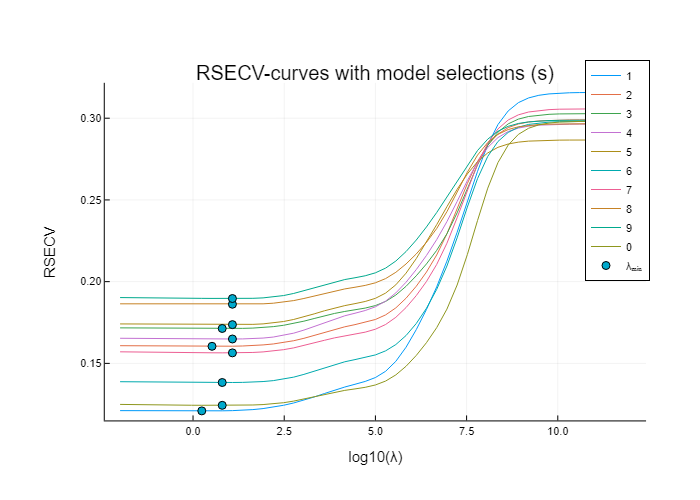

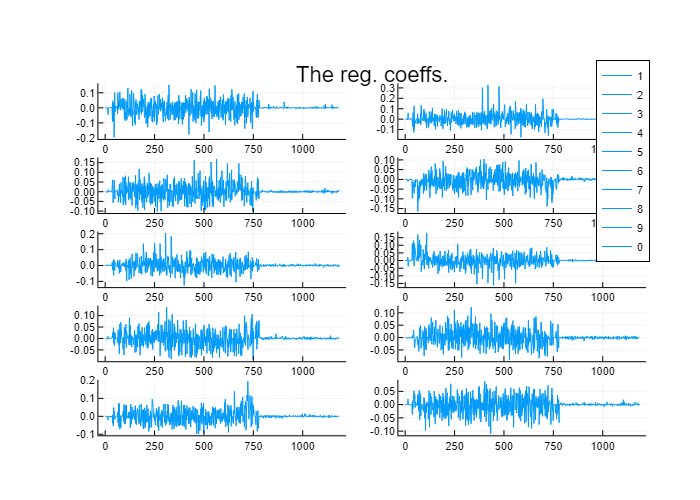

In [31]:
# ---------------------------------------------------------
# Plot the RSECV-curves
labs = reshape(string.(rem.(1:ng,ng)), 1,ng) # Class labels (1,2,3,...,9,0)
RSECV = copy(press); for k = 1:ng RSECV[k] = sqrt.(press[k]/m); end
RSECV_plt = plot(log10.(λs'), RSECV, label = labs, xlabel = "log10(λ)", ylabel = "RSECV", title = "RSECV-curves with model selections (s)")
minRSECV = zeros(ng,1); for k = 1:ng minRSECV[k] = RSECV[k][minid[k]]; end;
RSECV_plt = scatter!(log10.(λs')[minid], minRSECV, label = "λₘᵢₙ")
display(RSECV_plt)

# ---------------------------------------------------------
# Plotting of the regression coeffs:
#labs = reshape(string.(rem.(1:ng,ng)), 1,ng) # Class labels (1,2,3,...,9,0)
bb = copy(bλ); for k = 1:10 bb[k]=bb[k][2:end]; end
reg_coeff_plot = plot(bb, layout = (5,2), label = labs, plot_title = "The reg. coeffs.")
display(reg_coeff_plot)

### Generate confusion-matrices and error probabilities from classifications of the training data:

In [32]:
# ---------------------------------------------------------
# Generate confusion-matrices for the training data classifications:
CMTr = zeros(Int,ng,ng); CMcv = zeros(Int,ng,ng);
for k = 1:length(Gtrain)
    CMTr[Gtrain[k], Ghat[k]] += 1; CMcv[Gtrain[k], GhatCV[k]] += 1;
end

pCMTr = 100*float(CMTr)./float(sum(CMTr,dims = 2));
pCMcv = 100*float(CMcv)./float(sum(CMcv,dims = 2));
pCorrectTr = 100*sum(diag(CMTr))/m # % correct classifications of traning-dara
pCorrectCV = 100*sum(diag(CMcv))/m # % crossvalidated correct classifications

# ---------------------------------------------------------
# Compute predictions (Ypred) or the test-data:
Ypred = zeros(mte,ng);
for k = 1:ng
Ypred[:,k] = bλ[k][1].+ XteR*bλ[k][2:end]; # The testset predictions
end

# The resulting predicted groups:
Gpred = getindex.(argmax(Ypred, dims=2),2);

#CMTr 
#CMcv
#pCMcv
pCorrectTr, pCorrectCV

(92.975, 92.36833333333334)

### Generate confusion-matrix and error probabilities for the test-data classifications:

In [33]:
# ---------------------------------------------------------
# Generate confusion-matrix for the test-data classifications:
CMpr = zeros(Int,ng,ng);
for k = 1:length(Gtest)
    CMpr[Gtest[k], Gpred[k]] += 1;
end
pCMpr = 100*float(CMpr)./float(sum(CMpr,dims = 2));
pCorrectPred = 100*sum(diag(CMpr))/mte # % correct classifications of test-dara

pCMpr

10×10 Matrix{Float64}:
 98.326      0.264317   0.264317  …   0.61674    0.0        0.0
  0.387597  89.0504     1.55039       3.77907    0.484496   0.775194
  0.19802    1.38614   92.4752        1.18812    0.594059   0.19802
  1.222      0.305499   0.0           0.509165   4.27699    0.203666
  0.336323   0.112108   3.13901       2.13004    0.560538   1.12108
  0.417537   0.521921   0.0       …   0.313152   0.0        1.35699
  1.94553    1.84825    0.389105      0.291829   3.01556    0.291829
  0.513347   0.616016   1.54004      89.8357     1.02669    1.02669
  0.693756   0.198216   1.48662       0.792864  89.4945     0.891972
  0.0        0.102041   0.204082      0.204082   0.0       98.2653

###  Plot of % correctly classified test-samples in each group (change to bar-plot):

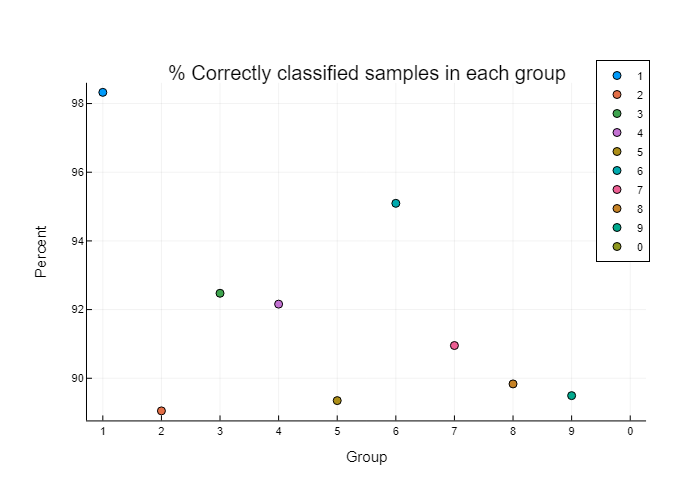

In [34]:
# ---------------------------------------------------------
# For the test-data: Plot of % correctly classified samples in each group (a bar-plot should be better :-).
display(scatter(labs, diag(pCMpr)', label = labs, title = "% Correctly classified samples in each group", xlabel = "Group", ylabel = "Percent"))


### Exercise 4 - the questions:
1. Repeat the above calculations using: 
    * the original pixel-features together with 6000 features obtained by multiplication with a ($\pm 1$) random matrix (R)
    * the features obtained by selecting and thresholding 100 samples from each class to obtain an alternative ($\pm 1$) matrix (R).
    * the features obtained by using basis vectors from Non-negative Matrix Factorization from each digit group (Optional)
2. Identify and threshold the misclassified training samples to extend the ($\pm 1$)-matrix (R). Use the exteded R to generate more features and repeat the classification modelling. How much did the testset-classifications improve?
3. The clusterings i Exercise 2 can be used to design a 30-class classification problem.
    * Suggest a strategy for solving of the 10-class classification problem based on first solving the 30-class classification problem.
    * First explore your strategy based on the original features only.
    * Then repeat your strategy by using the additional R-features.

#### Exercise 4.1.1

I calculate with only 1000 features as my PC is not able to handle more. I only have 8 GB of RAM where 6.94 are usable.

In [36]:
nrf  = 1000;  # = 5000 (6000)     # The number of random features to be generated.
R    = 2.0*bitrand(n,nrf).-1;
R_XtrR = max.(Xtrain*R,0)
R_XTeR = max.(Xtest*R,0)
XtrR = [Xtrain R_XtrR];
XteR = [Xtest  R_XTeR];

In [37]:
# ---------------------------------------------------------
# Do classification by regression (Fast CV-Tikhonov regression with several responses)
low  = -2; high = 12; nλ = 101;    # Range of reg. parameter values.
λs   = 10 .^(range(low,high,length = nλ))'; # Regularization parameter values.
@time press, minid, U, σ, V, H, bcoefs, λ, bλ, hλ = TregsYLooCV(XtrR, Ytrain, λs);

 81.325008 seconds (496 allocations: 5.123 GiB, 17.70% gc time)


In [38]:
# ---------------------------------------------------------
# Compute fitted values (Yhat) and Cross-validated predictions (YhatCV) from the minimum CV-error models based on TregsYLooCV:
Yhat = zeros(m,ng); YhatCV = zeros(m,ng);
for k = 1:ng
Yhat[:,k]   = bλ[k][1] .+ XtrR*bλ[k][2:end]; # The fitted values.
YhatCV[:,k] = (Yhat[:,k] - hλ[k].*Ytrain[:,k])./(1 .-hλ[k]); # The CV predictions.
end

# The resulting predicted groups:
Ghat   = getindex.(argmax(Yhat, dims=2),2);
GhatCV = getindex.(argmax(YhatCV, dims=2),2);

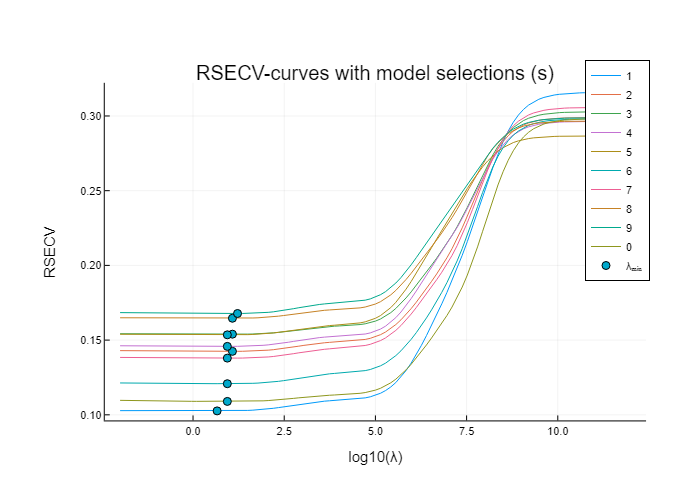

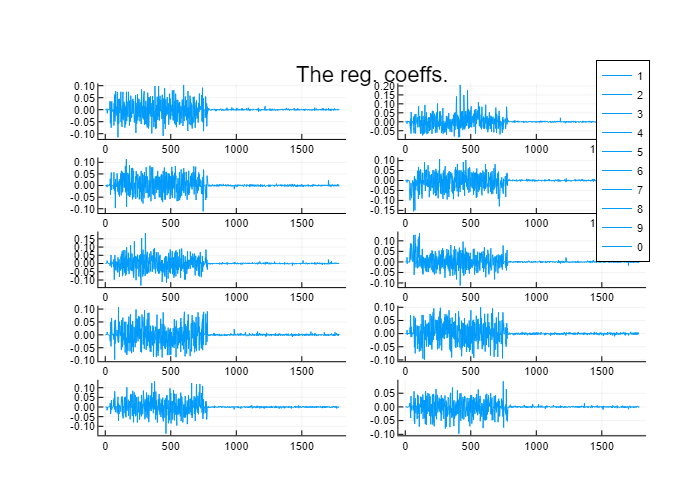

In [39]:
# ---------------------------------------------------------
# Plot the RSECV-curves
labs = reshape(string.(rem.(1:ng,ng)), 1,ng) # Class labels (1,2,3,...,9,0)
RSECV = copy(press); for k = 1:ng RSECV[k] = sqrt.(press[k]/m); end
RSECV_plt = plot(log10.(λs'), RSECV, label = labs, xlabel = "log10(λ)", ylabel = "RSECV", title = "RSECV-curves with model selections (s)")
minRSECV = zeros(ng,1); for k = 1:ng minRSECV[k] = RSECV[k][minid[k]]; end;
RSECV_plt = scatter!(log10.(λs')[minid], minRSECV, label = "λₘᵢₙ")
display(RSECV_plt)

# ---------------------------------------------------------
# Plotting of the regression coeffs:
#labs = reshape(string.(rem.(1:ng,ng)), 1,ng) # Class labels (1,2,3,...,9,0)
bb = copy(bλ); for k = 1:10 bb[k]=bb[k][2:end]; end
reg_coeff_plot = plot(bb, layout = (5,2), label = labs, plot_title = "The reg. coeffs.")
display(reg_coeff_plot)

In [40]:
# ---------------------------------------------------------
# Generate confusion-matrices for the training data classifications:
CMTr = zeros(Int,ng,ng); CMcv = zeros(Int,ng,ng);
for k = 1:length(Gtrain)
    CMTr[Gtrain[k], Ghat[k]] += 1; CMcv[Gtrain[k], GhatCV[k]] += 1;
end

pCMTr = 100*float(CMTr)./float(sum(CMTr,dims = 2));
pCMcv = 100*float(CMcv)./float(sum(CMcv,dims = 2));
pCorrectTr = 100*sum(diag(CMTr))/m # % correct classifications of traning-dara
pCorrectCV = 100*sum(diag(CMcv))/m # % crossvalidated correct classifications

# ---------------------------------------------------------
# Compute predictions (Ypred) or the test-data:
Ypred = zeros(mte,ng);
for k = 1:ng
Ypred[:,k] = bλ[k][1].+ XteR*bλ[k][2:end]; # The testset predictions
end

# The resulting predicted groups:
Gpred = getindex.(argmax(Ypred, dims=2),2);

#CMTr 
#CMcv
#pCMcv
pCorrectTr, pCorrectCV

(95.42333333333333, 94.75166666666667)

In [41]:
# ---------------------------------------------------------
# Generate confusion-matrix for the test-data classifications:
CMpr = zeros(Int,ng,ng);
for k = 1:length(Gtest)
    CMpr[Gtest[k], Gpred[k]] += 1;
end
pCMpr = 100*float(CMpr)./float(sum(CMpr,dims = 2));
pCorrectPred = 100*sum(diag(CMpr))/mte # % correct classifications of test-dara

pCMpr

10×10 Matrix{Float64}:
 98.9427      0.264317   0.176211  …   0.0881057   0.0        0.0
  0.0968992  93.4109     1.25969       2.13178     0.387597   0.678295
  0.0990099   1.38614   93.4653        1.08911     0.49505    0.0
  0.610998    0.305499   0.101833      0.305499    2.64766    0.203666
  0.0         0.112108   2.13004       0.336323    0.560538   0.560538
  0.417537    0.208768   0.104384  …   0.313152    0.104384   0.730689
  1.26459     1.55642    0.291829      0.389105    1.75097    0.194553
  0.102669    0.616016   1.43737      92.9158      0.410678   0.513347
  0.693756    0.0        1.58573       0.49554    91.9722     0.693756
  0.102041    0.102041   0.102041      0.306122    0.0       98.7755

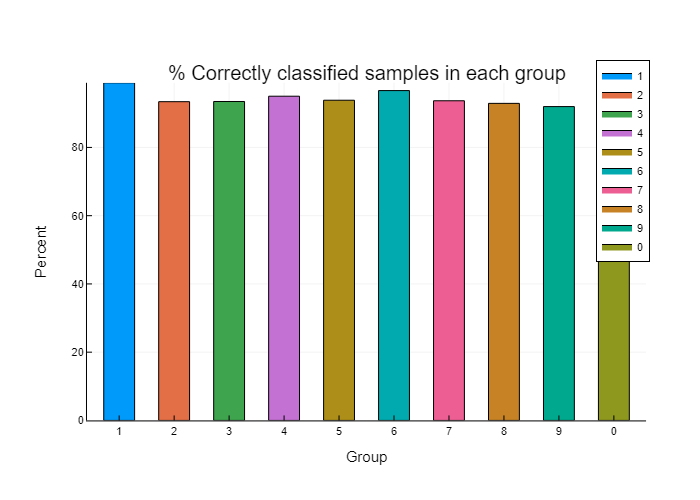

In [42]:
# ---------------------------------------------------------
# For the test-data: Plot of % correctly classified samples in each group (a bar-plot should be better :-).
display(bar(labs, diag(pCMpr)', label = labs, title = "% Correctly classified samples in each group", xlabel = "Group", ylabel = "Percent"))

#### Exercise 4.1.2

In [43]:
# Randomly sample 100 images from each group
n_images = 100
threshold_value = 0.5
R₁₂ = zeros(size(Xtrain, 2), 1000)

for g=1:ng
    g_idx = findall(x -> x == g, Gtrain)
    X_g = Xtrain[g_idx, :] # m_g x 784
    sampled_idx = rand(1:size(X_g, 1), n_images)
    sampled_X_g = X_g[sampled_idx, :]'
    sampled_X_g = ifelse.(sampled_X_g .< threshold_value, -1, 1)
    R₁₂[:, (g-1)*n_images+1:g*n_images] = sampled_X_g
end


In [44]:
XtrR_2 = max.(Xtrain * R₁₂, 0);
XteR_2 = max.(Xtest * R₁₂, 0);

In [45]:
low = -2; high = 12; nλ = 101;    # Range of reg. parameter values.
λs   = 10 .^(range(low,high,length = nλ))'; # Regularization parameter values.
@time press, minid, U, σ, V, H, bcoefs, λ, bλ, hλ = TregsYLooCV(XtrR_2, Ytrain, λs);

 35.588437 seconds (496 allocations: 3.310 GiB, 23.40% gc time)


In [46]:
Yhat = zeros(m,ng); YhatCV = zeros(m,ng);
for k = 1:ng
    Yhat[:,k]   = bλ[k][1] .+ XtrR_2*bλ[k][2:end]; # The fitted values.
    YhatCV[:,k] = (Yhat[:,k] - hλ[k].*Ytrain[:,k])./(1 .-hλ[k]); # The CV predictions.
end

# The resulting predicted groups:
Ghat   = getindex.(argmax(Yhat, dims=2),2);
GhatCV = getindex.(argmax(YhatCV, dims=2),2);

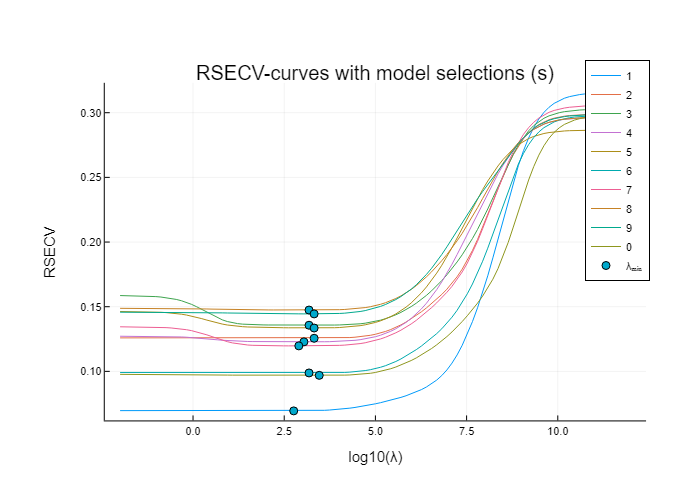

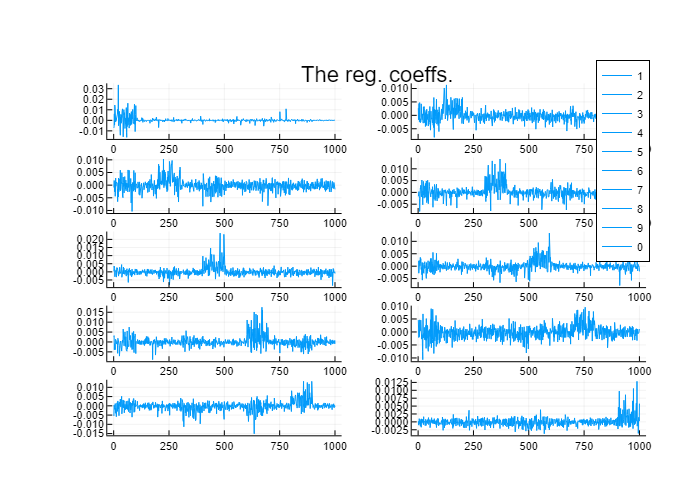

In [47]:
# ---------------------------------------------------------
# Plot the RSECV-curves
labs = reshape(string.(rem.(1:ng,ng)), 1,ng) # Class labels (1,2,3,...,9,0)
RSECV = copy(press); for k = 1:ng RSECV[k] = sqrt.(press[k]/m); end
RSECV_plt = plot(log10.(λs'), RSECV, label = labs, xlabel = "log10(λ)", ylabel = "RSECV", title = "RSECV-curves with model selections (s)")
minRSECV = zeros(ng,1); for k = 1:ng minRSECV[k] = RSECV[k][minid[k]]; end;
RSECV_plt = scatter!(log10.(λs')[minid], minRSECV, label = "λₘᵢₙ")
display(RSECV_plt)

# ---------------------------------------------------------
# Plotting of the regression coeffs:
#labs = reshape(string.(rem.(1:ng,ng)), 1,ng) # Class labels (1,2,3,...,9,0)
bb = copy(bλ); for k = 1:10 bb[k]=bb[k][2:end]; end
reg_coeff_plot = plot(bb, layout = (5,2), label = labs, plot_title = "The reg. coeffs.")
display(reg_coeff_plot)

In [48]:
# ---------------------------------------------------------
# Generate confusion-matrices for the training data classifications:
CMTr = zeros(Int,ng,ng); CMcv = zeros(Int,ng,ng);
for k = 1:length(Gtrain)
    CMTr[Gtrain[k], Ghat[k]] += 1; CMcv[Gtrain[k], GhatCV[k]] += 1;
end

pCMTr = 100*float(CMTr)./float(sum(CMTr,dims = 2));
pCMcv = 100*float(CMcv)./float(sum(CMcv,dims = 2));
pCorrectTr = 100*sum(diag(CMTr))/m # % correct classifications of traning-dara
pCorrectCV = 100*sum(diag(CMcv))/m # % crossvalidated correct classifications

# ---------------------------------------------------------
# Compute predictions (Ypred) or the test-data:
Ypred = zeros(mte,ng);
for k = 1:ng
    Ypred[:,k] = bλ[k][1].+ XteR_2*bλ[k][2:end]; # The testset predictions
end

# The resulting predicted groups:
Gpred₁₂ = getindex.(argmax(Ypred, dims=2),2);

#CMTr 
#CMcv
#pCMcv
pCorrectTr, pCorrectCV

(95.86666666666666, 95.53333333333333)

In [49]:
# ---------------------------------------------------------
# Generate confusion-matrix for the test-data classifications:
CMpr = zeros(Int,ng,ng);
for k = 1:length(Gtest)
    CMpr[Gtest[k], Gpred₁₂[k]] += 1;
end
pCMpr = 100*float(CMpr)./float(sum(CMpr,dims = 2));
pCorrectPred = 100*sum(diag(CMpr))/mte # % correct classifications of test-dara

pCMpr

10×10 Matrix{Float64}:
 98.2379     0.440529   0.176211  …   0.704846    0.0        0.0
  0.0       94.6705     0.484496      2.22868     0.0        1.25969
  0.0        0.49505   95.2475        1.28713     0.29703    0.0990099
  0.0        0.407332   0.0           0.305499    2.44399    0.101833
  0.0        0.336323   2.57848       0.896861    0.224215   0.560538
  0.313152   0.0        0.0       …   0.521921    0.0        1.14823
  0.680934   1.84825    0.291829      0.0972763   1.94553    0.194553
  0.0        0.718686   1.23203      94.8665      0.513347   0.308008
  0.792864   0.297324   0.792864      0.594648   93.3598     0.693756
  0.0        0.204082   0.0           0.204082    0.0       98.5714

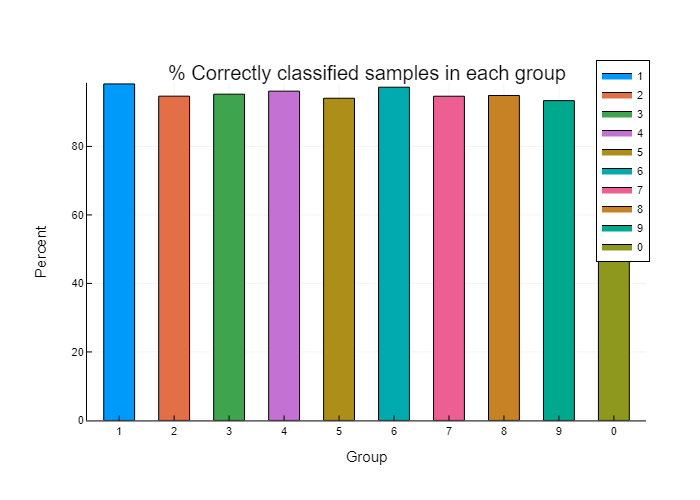

In [50]:
display(bar(labs, diag(pCMpr)', label = labs, title = "% Correctly classified samples in each group", xlabel = "Group", ylabel = "Percent"))

#### Exercise 4.2

Using the misclassified samples from 4.1.2 to extend the matrix R.

In [51]:
threshold_value = 0.5
misclassified_idx = findall(x -> x != 0, vec(Ghat) .- Gtrain)
R_2 = Xtrain[misclassified_idx, :];
R_2 = ifelse.(R_2 .< threshold_value, -1, 1)
R_1 = copy(R₁₂)
R = [R_1 R_2'];

In [52]:
XtrR₂= max.(Xtrain * R, 0);
XteR₂ = max.(Xtest * R, 0);

In [53]:
# low = -2; high = 12; nλ = 101;    # Range of reg. parameter values.
low = -2; high = 12; nλ = 50;    # Range of reg. parameter values.
λs   = 10 .^(range(low,high,length = nλ))'; # Regularization parameter values.
@time press, minid, U, σ, V, H, bcoefs, λ, bλ, hλ = TregsYLooCV(XtrR₂, Ytrain, λs);

456.786994 seconds (550 allocations: 8.848 GiB, 15.76% gc time)


In [54]:
Yhat = zeros(m,ng); YhatCV = zeros(m,ng);
for k = 1:ng
    Yhat[:,k]   = bλ[k][1] .+ XtrR₂*bλ[k][2:end]; # The fitted values.
    YhatCV[:,k] = (Yhat[:,k] - hλ[k].*Ytrain[:,k])./(1 .-hλ[k]); # The CV predictions.
end

# The resulting predicted groups:
Ghat   = getindex.(argmax(Yhat, dims=2),2);
GhatCV = getindex.(argmax(YhatCV, dims=2),2);

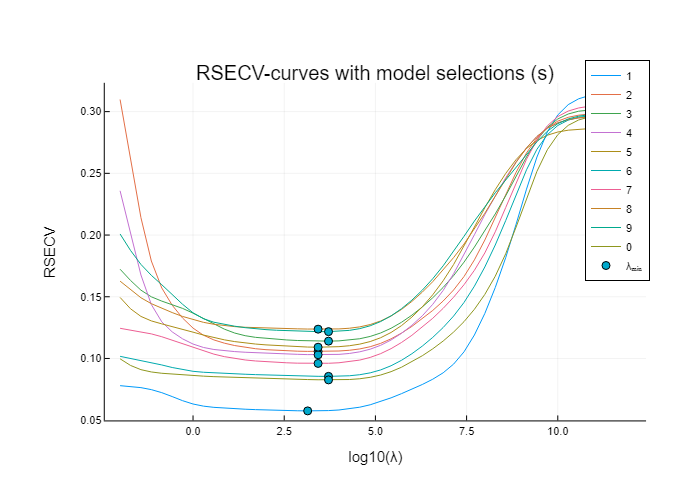

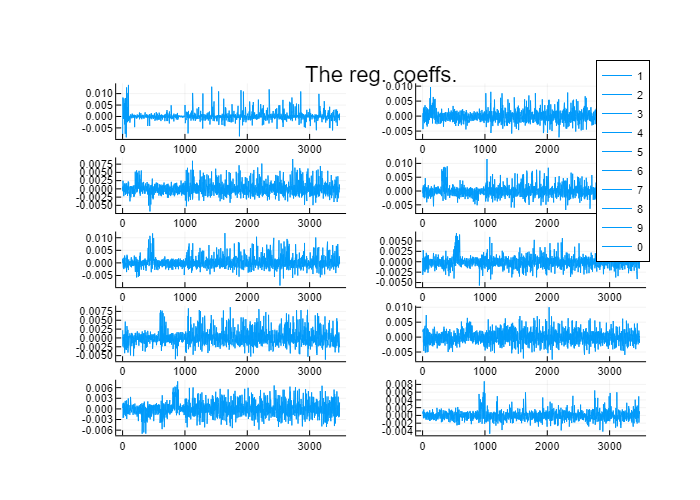

In [55]:
# ---------------------------------------------------------
# Plot the RSECV-curves
labs = reshape(string.(rem.(1:ng,ng)), 1,ng) # Class labels (1,2,3,...,9,0)
RSECV = copy(press); for k = 1:ng RSECV[k] = sqrt.(press[k]/m); end
RSECV_plt = plot(log10.(λs'), RSECV, label = labs, xlabel = "log10(λ)", ylabel = "RSECV", title = "RSECV-curves with model selections (s)")
minRSECV = zeros(ng,1); for k = 1:ng minRSECV[k] = RSECV[k][minid[k]]; end;
RSECV_plt = scatter!(log10.(λs')[minid], minRSECV, label = "λₘᵢₙ")
display(RSECV_plt)

# ---------------------------------------------------------
# Plotting of the regression coeffs:
#labs = reshape(string.(rem.(1:ng,ng)), 1,ng) # Class labels (1,2,3,...,9,0)
bb = copy(bλ); for k = 1:10 bb[k]=bb[k][2:end]; end
reg_coeff_plot = plot(bb, layout = (5,2), label = labs, plot_title = "The reg. coeffs.")
display(reg_coeff_plot)

In [56]:
# ---------------------------------------------------------
# Generate confusion-matrices for the training data classifications:
CMTr = zeros(Int,ng,ng); CMcv = zeros(Int,ng,ng);
for k = 1:length(Gtrain)
    CMTr[Gtrain[k], Ghat[k]] += 1; CMcv[Gtrain[k], GhatCV[k]] += 1;
end

pCMTr = 100*float(CMTr)./float(sum(CMTr,dims = 2));
pCMcv = 100*float(CMcv)./float(sum(CMcv,dims = 2));
pCorrectTr = 100*sum(diag(CMTr))/m # % correct classifications of traning-dara
pCorrectCV = 100*sum(diag(CMcv))/m # % crossvalidated correct classifications

# ---------------------------------------------------------
# Compute predictions (Ypred) or the test-data:
Ypred = zeros(mte,ng);
for k = 1:ng
    Ypred[:,k] = bλ[k][1].+ XteR₂*bλ[k][2:end]; # The testset predictions
end

# The resulting predicted groups:
Gpred₂ = getindex.(argmax(Ypred, dims=2),2);

#CMTr 
#CMcv
#pCMcv
pCorrectTr, pCorrectCV

(98.67333333333333, 97.815)

In [57]:
# ---------------------------------------------------------
# Generate confusion-matrix for the test-data classifications:
CMpr = zeros(Int,ng,ng);
for k = 1:length(Gtest)
    CMpr[Gtest[k], Gpred₂[k]] += 1;
end
pCMpr = 100*float(CMpr)./float(sum(CMpr,dims = 2));
pCorrectPred = 100*sum(diag(CMpr))/mte # % correct classifications of test-dara

pCMpr

10×10 Matrix{Float64}:
 99.4714     0.176211   0.0881057  …   0.176211    0.0        0.0
  0.0       97.3837     0.193798       0.968992    0.0        0.581395
  0.0        0.49505   96.5347         0.891089    0.29703    0.0
  0.0        0.305499   0.0            0.101833    1.222      0.0
  0.112108   0.112108   0.896861       0.112108    0.112108   0.336323
  0.208768   0.0        0.0        …   0.208768    0.0        0.730689
  0.486381   0.972763   0.0            0.0972763   1.45914    0.291829
  0.0        0.102669   0.513347      98.152       0.205339   0.205339
  0.198216   0.099108   0.891972       0.297324   95.8375     0.396432
  0.0        0.102041   0.0            0.204082    0.0       99.1837

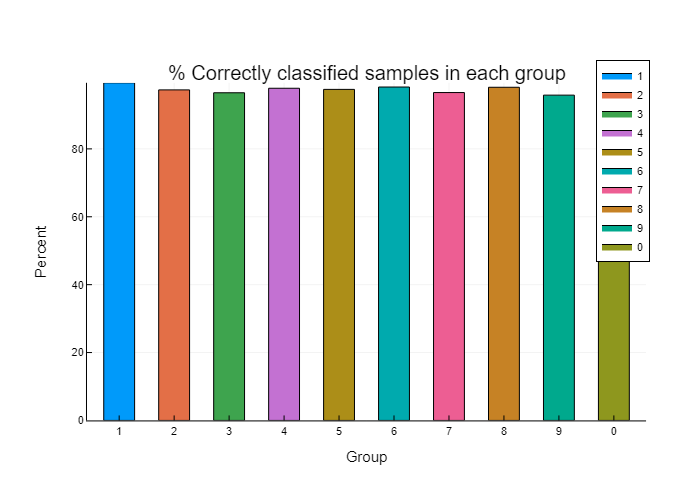

In [58]:
display(bar(labs, diag(pCMpr)', label = labs, title = "% Correctly classified samples in each group", xlabel = "Group", ylabel = "Percent"))

In [59]:
using DataFrames 

test_acc₁₂ = (sum(Gpred₁₂.== Gtest , dims=1)/mte)[1]
test_acc₂ = (sum(Gpred₂.== Gtest , dims=1)/mte)[1]

df = DataFrame(R = ["Randomly sampled", "Randomly sampled+misclassified"], 
                test_accuracy = [test_acc₁₂, test_acc₂])

Row,R,test_accuracy
,String,Float64
1,Randomly sampled,0.9574
2,Randomly sampled+misclassied,0.9769


#### Exercise 4.3

1. Do the clustering on the training data and map each sample to one of 30 classes. If a sample belongs to digit 1 it is assigned as either      class 1, 2 or 3, digit 2 to class 4, 5 or 6, etc.
2. One-hot encode the cluster labels to get a 30-dimensional vector for each sample. This will be our new target $Y$ we train with.
3. Train a classifier by the help of the training data and the one-hot encoded labels
4. Predict the labels of the test data
5. Map the predicted labels back to the original 10 classes


In [4]:
function assign_labels(X, old_labels, ng, k=3)
    assigned_labels = zeros(size(X, 1))
    for g = 1:ng
        g_idx = findall(x -> x == g, old_labels)
        X_g = eachrow(X[g_idx, :])
        labels, _, _ = kmeans_(X_g, k)
        assigned_labels[g_idx] = (g - 1)*k .+labels
    end
    return assigned_labels
end

assign_labels (generic function with 2 methods)

In [5]:
function OneHotEncoder(label_vector)
    labels = unique(label_vector)
    n_labels = length(labels)
    n_samples = length(label_vector)
    one_hot_enc = zeros(Int, n_samples, n_labels)

    for (i, label) in enumerate(labels)
        label_idx = findall(x -> x == label, label_vector)
        one_hot_enc[label_idx, label] .= 1 
    end
    return one_hot_enc
end

OneHotEncoder (generic function with 1 method)

In [6]:
cluster_labels = Int.(assign_labels(Xtrain, Gtrain, ng));

Iteration 1: Jclust = 22.31017218979959.


Iteration 2: Jclust = 14.497544556613146.


Iteration 3: Jclust = 13.664837393155288.


Iteration 4: Jclust = 13.62536800222027.


Iteration 5: Jclust = 13.613998396460333.


Iteration 6: Jclust = 13.60589056885975.


Iteration 7: Jclust = 13.600497369774622.


Iteration 8: Jclust = 13.596408803546527.


Iteration 9: Jclust = 13.592300086957174.


Iteration 10: Jclust = 13.590189773072733.


Iteration 11: Jclust = 13.588912378625238.


Iteration 12: Jclust = 13.587898163508935.


Iteration 13: Jclust = 13.587426085704683.


Iteration 14: Jclust = 13.587034607225117.


Iteration 15: Jclust = 13.58679409969287.


Iteration 16: Jclust = 13.586648669600752.


Iteration 17: Jclust = 13.586433297651837.


Iteration 18: Jclust = 13.586296509400716.


Iteration 19: Jclust = 13.586275620007113.


Iteration 1: Jclust = 50.40422415595708.


Iteration 2: Jclust = 45.96393887124206.


Iteration 3: Jclust = 44.72711582837601.


Iteration 4: Jclust = 44.30663430040143.


Iteration 5: Jclust = 44.19042584570929.


Iteration 6: Jclust = 44.14393204232325.


Iteration 7: Jclust = 44.12652296554563.


Iteration 8: Jclust = 44.11991993286121.


Iteration 9: Jclust = 44.11651584509418.


Iteration 10: Jclust = 44.114909710168135.


Iteration 11: Jclust = 44.11368357965575.


Iteration 12: Jclust = 44.11315378537824.


Iteration 13: Jclust = 44.11285655537279.


Iteration 1: Jclust = 44.76745292240222.


Iteration 2: Jclust = 41.85405333302627.


Iteration 3: Jclust = 40.279708323878076.


Iteration 4: Jclust = 39.65012680029103.


Iteration 5: Jclust = 39.38438800234075.


Iteration 6: Jclust = 39.25491055214067.


Iteration 7: Jclust = 39.17898432876015.


Iteration 8: Jclust = 39.133210719730435.


Iteration 9: Jclust = 39.10042484779802.


Iteration 10: Jclust = 39.07083387307763.


Iteration 11: Jclust = 39.045351497632225.


Iteration 12: Jclust = 39.02212977614441.


Iteration 13: Jclust = 38.994602649467744.


Iteration 14: Jclust = 38.96529189454591.


Iteration 15: Jclust = 38.945686342005786.


Iteration 16: Jclust = 38.934226378956296.


Iteration 17: Jclust = 38.92515260454394.


Iteration 18: Jclust = 38.91868475822046.


Iteration 19: Jclust = 38.91368649815134.


Iteration 20: Jclust = 38.91033449158152.


Iteration 21: Jclust = 38.90756169745365.


Iteration 22: Jclust = 38.90567296344842.


Iteration 23: Jclust = 38.90405976311412.


Iteration 24: Jclust = 38.902422347082236.


Iteration 25: Jclust = 38.90095877913518.


Iteration 26: Jclust = 38.89979290869277.


Iteration 27: Jclust = 38.89894130656999.


Iteration 28: Jclust = 38.8982621730078.


Iteration 29: Jclust = 38.89787487419226.


Iteration 1: Jclust = 40.624921685111104.


Iteration 2: Jclust = 36.84946121045639.
Iteration 3: Jclust = 36.512846692918615.


Iteration 4: Jclust = 36.281506115015034.


Iteration 5: Jclust = 36.043381204916805.


Iteration 6: Jclust = 35.82321938926777.


Iteration 7: Jclust = 35.57051116659916.


Iteration 8: Jclust = 35.336331431558314.


Iteration 9: Jclust = 35.17021665666673.


Iteration 10: Jclust = 35.10239789092616.


Iteration 11: Jclust = 35.074600494180196.
Iteration 12: Jclust = 35.06254715657196.


Iteration 13: Jclust = 35.054915326124586.
Iteration 14: Jclust = 35.04883978345869.


Iteration 15: Jclust = 35.04393307886448.
Iteration 16: Jclust = 35.03964340988237.


Iteration 17: Jclust = 35.0368548029889.


Iteration 18: Jclust = 35.03451690753362.


Iteration 19: Jclust = 35.032319018515444.
Iteration 20: Jclust = 35.03104623423573.


Iteration 21: Jclust = 35.030104186025405.


Iteration 22: Jclust = 35.02945923301943.


Iteration 23: Jclust = 35.02874307955709.


Iteration 24: Jclust = 35.02809115055771.


Iteration 25: Jclust = 35.026977140904535.


Iteration 26: Jclust = 35.02558560225993.
Iteration 27: Jclust = 35.02454905488005.


Iteration 28: Jclust = 35.023643801892405.


Iteration 29: Jclust = 35.02302013028488.


Iteration 30: Jclust = 35.02242986611879.
Iteration 31: Jclust = 35.02208828593755.


Iteration 1: Jclust = 46.94351010113532.


Iteration 2: Jclust = 40.915668467476955.


Iteration 3: Jclust = 39.87280475912542.


Iteration 4: Jclust = 39.36746798622606.


Iteration 5: Jclust = 39.08128816841922.


Iteration 6: Jclust = 38.93358675604725.


Iteration 7: Jclust = 38.85281781387866.
Iteration 8: Jclust = 38.80772343669901.


Iteration 9: Jclust = 38.77774618845305.


Iteration 10: Jclust = 38.76136914284763.


Iteration 11: Jclust = 38.75134503328597.


Iteration 12: Jclust = 38.74562417748451.


Iteration 13: Jclust = 38.74228910273118.


Iteration 14: Jclust = 38.740098526458475.


Iteration 15: Jclust = 38.738936233012616.


Iteration 16: Jclust = 38.73835807041035.


Iteration 17: Jclust = 38.738033432655136.


Iteration 1: Jclust = 42.58692355323163.


Iteration 2: Jclust = 35.48330004216159.


Iteration 3: Jclust = 34.9383589292331.


Iteration 4: Jclust = 34.837804656716976.


Iteration 5: Jclust = 34.799552389897734.


Iteration 6: Jclust = 34.78102919018956.


Iteration 7: Jclust = 34.770635709530445.
Iteration 8: Jclust = 34.76366159013641.


Iteration 9: Jclust = 34.759586569839605.


Iteration 10: Jclust = 34.7557758196462.


Iteration 11: Jclust = 34.75312688220622.
Iteration 12: Jclust = 34.751870733664305.


Iteration 13: Jclust = 34.750952443097525.
Iteration 14

: Jclust = 34.750262389908556.
Iteration 15: Jclust = 34.749917053764406.


Iteration 1: Jclust = 37.246515811310125.


Iteration 2: Jclust = 34.924104929522805.


Iteration 3: Jclust = 33.27903706332868.


Iteration 4: Jclust = 32.38827280977018.


Iteration 5: Jclust = 31.68764860692105.


Iteration 6: Jclust = 31.074475524331138.


Iteration 7: Jclust = 30.742777317972973.


Iteration 8: Jclust = 30.644496437802584.


Iteration 9: Jclust = 30.603870530590005.


Iteration 10: Jclust = 30.585944251639212.


Iteration 11: Jclust = 30.576043748253515.


Iteration 12: Jclust = 30.570168376931047.


Iteration 13: Jclust = 30.566380403644203.


Iteration 14: Jclust = 30.563098728686843.


Iteration 15: Jclust = 30.560565046666348.


Iteration 16: Jclust = 30.559026270591303.


Iteration 17: Jclust = 30.5585453316037.


Iteration 18: Jclust = 30.558225700795866.


Iteration 19: Jclust = 30.55799137665959.


Iteration 1: Jclust = 45.34704758192235.


Iteration 2: Jclust = 41.437394262194886.


Iteration 3: Jclust = 40.24016678800866.


Iteration 4: Jclust = 39.95382886883042.


Iteration 5: Jclust = 39.780685876899184.


Iteration 6: Jclust = 39.66547913721855.


Iteration 7: Jclust = 39.594913790727716.


Iteration 8: Jclust = 39.55768387491361.


Iteration 9: Jclust = 39.53176356541156.


Iteration 10: Jclust = 39.519180569077136.


Iteration 11: Jclust = 39.51330409127383.


Iteration 12: Jclust = 39.509200595208846.


Iteration 13: Jclust = 39.50729388523613.


Iteration 14: Jclust = 39.506384595635865.


Iteration 15: Jclust = 39.50581342152729.


Iteration 16: Jclust = 39.50537332865471.


Iteration 17: Jclust = 39.505023303646915.


Iteration 1: Jclust = 38.28822431401557.


Iteration 2: Jclust = 32.92839909580361.


Iteration 3: Jclust = 32.10191947934521.


Iteration 4: Jclust = 31.687898555580816.


Iteration 5: Jclust = 31.51714406742923.


Iteration 6: Jclust = 31.47400109286265.


Iteration 7: Jclust = 31.460056788782577.


Iteration 8: Jclust = 31.453347744173186.


Iteration 9: Jclust = 31.45001501349799.


Iteration 10: Jclust = 31.44789720050802.


Iteration 11: Jclust = 31.44492912052197.


Iteration 12: Jclust = 31.44146453685471.


Iteration 13: Jclust = 31.439343878542193.


Iteration 14: Jclust = 31.437870802692775.


Iteration 15: Jclust = 31.43726561040226.


Iteration 16: Jclust = 31.43708886607465.


Iteration 1: Jclust = 49.48200401100235.


Iteration 2: Jclust = 42.07811941741488.


Iteration 3: Jclust = 40.752405442223186.


Iteration 4: Jclust = 40.528662497737486.


Iteration 5: Jclust = 40.42533222080939.


Iteration 6: Jclust = 40.3251047757816.


Iteration 7: Jclust = 40.23649416775511.


Iteration 8: Jclust = 40.14464708898029.


Iteration 9: Jclust = 40.07248380607901.


Iteration 10: Jclust = 40.00320651647898.


Iteration 11: Jclust = 39.952603404839515.


Iteration 12: Jclust = 39.926627143647465.


Iteration 13: Jclust = 39.90047217413341.


Iteration 14: Jclust = 39.87105773339102.


Iteration 15: Jclust = 39.849355882701815.


Iteration 16: Jclust = 39.831821959755864.


Iteration 17: Jclust = 39.81997213347156.


Iteration 18: Jclust = 39.808691282796964.


Iteration 19: Jclust = 39.79799394654218.


Iteration 20: Jclust = 39.789441533933086.


Iteration 21: Jclust = 39.78020705420614.


Iteration 22: Jclust = 39.77226139813862.


Iteration 23: Jclust = 39.76705078923208.


Iteration 24: Jclust = 39.76342989801785.


Iteration 25: Jclust = 39.76141736199318.
Iteration 26: Jclust = 39.7602733153157.


Iteration 27: Jclust = 39.75989656989584.

In [8]:
one_hot_enc = OneHotEncoder(cluster_labels);

In [10]:
λₛ = 10 .^(range(-2 , 10,length = 101))';
@time press, minid, U, σ, V, H, bcoefs, λ, bλ, hλ = TregsYLooCV(Xtrain, one_hot_enc, λₛ);

 39.366517 seconds (6.16 M allocations: 5.031 GiB, 2.78% gc time, 20.80% compilation time)


In [11]:
# Predict on the training data
n_labels = length(unique(cluster_labels))
Yhat = zeros(m, n_labels); YhatCV = zeros(m, n_labels);
for k = 1:n_labels
    Yhat[:,k]   = bλ[k][1] .+ Xtrain*bλ[k][2:end]; # The fitted values.
    YhatCV[:,k] = (Yhat[:,k] - hλ[k].*one_hot_enc[:,k])./(1 .-hλ[k]); # The CV predictions.
end

Ghat   = getindex.(argmax(Yhat, dims=2),2);
GhatCV = getindex.(argmax(YhatCV, dims=2),2);

In [12]:
# Generate confusion-matrices for the training data classifications:
CMTr = zeros(Int,n_labels, n_labels); CMcv = zeros(Int,n_labels, n_labels);
for k = 1:length(cluster_labels)
    CMTr[cluster_labels[k], Ghat[k]] += 1; CMcv[cluster_labels[k], GhatCV[k]] += 1;
end

pCMTr = 100*float(CMTr)./float(sum(CMTr, dims = 2));
pCMcv = 100*float(CMcv)./float(sum(CMcv, dims = 2));
pCorrectTr = 100*sum(diag(CMTr))/m # % correct classifications of traning-data
pCorrectCV = 100*sum(diag(CMcv))/m # % crossvalidated correct classifications

println(pCorrectTr,"   ", pCorrectCV)
CMTr

77.18833333333333   76.22166666666666


30×30 Matrix{Int64}:
 1638     0   105    1     1     6  …     0     0     0     0     0     0
    0  2408    45    3     0    15        0     1     2     0     0     0
   22    44  2323    1     0     7        0     0     1     0     0     0
   17    26    30  997   146   128        4     1     0     6    10    10
    4     2     3   54  1920    83        0     0     0    23    42     3
   51    12    45   78    80  1467  …     6     2     1    13     4     8
   13    19    26    0   109    15        0     0     5     8    17     3
    4    50    15    2     4     3       27    33    34     0     0     6
    2    15    15    0     9    26        0     0     0    11     4     9
   31     7    18    7     3     0        0    21    99     5     2     0
    ⋮                            ⋮  ⋱           ⋮                    
   33    41    14    1    17     2        2     2    60    12    30     2
   50    96   116    0     6     4        4    38    19    30     2     2
    9    54    49    

In [13]:
# % Correct classifications on training data when mapping to original labels
map2orig(Gpred) = div.((Gpred .+ 2), 3)
Ghat_map = map2orig(Ghat);
GhatCV_map = map2orig(GhatCV);

println(sum(Ghat_map .== Gtrain)/m)
println(sum(GhatCV_map .== Gtrain)/m)

0.8513166666666667
0.84535


In [14]:
# Compute predictions (Ypred) on the test-data:
Ypred = zeros(mte, n_labels);
for k = 1:n_labels
    Ypred[:,k] = bλ[k][1].+ Xtest*bλ[k][2:end]; # The testset predictions
end

# The resulting predicted groups:
Gpred = getindex.(argmax(Ypred, dims=2),2);
Gpred_map = map2orig(Gpred); # Map the predicted labels to the original 10 labels
sum(Gpred_map .== Gtest)/mte # % correct classifications of test-data

0.8513

In [15]:
# Generate confusion-matrix for the test-data classifications when mapping to original labels:
CMpr = zeros(Int, ng, ng);
for k = 1:length(Gtest)
    CMpr[Gtest[k], Gpred_map[k]] += 1;
end
pCMpr = 100*float(CMpr)./float(sum(CMpr,dims = 2));
pCorrectPred = 100*sum(diag(CMpr))/mte # % correct classifications of test-data

pCMpr

10×10 Matrix{Float64}:
 98.8546     0.352423   0.0       …   0.440529   0.0        0.0
  3.10078   81.4922     4.74806       2.81008    0.193798   2.13178
  2.27723    1.38614   85.4455        2.67327    1.18812    0.891089
  3.86965    0.610998   0.0           0.712831   9.2668     0.509165
  1.4574     0.672646   7.06278       5.9417     1.68161    1.56951
  0.835073   0.730689   0.0       …   0.208768   0.0        3.86221
  3.79377    1.07004    0.77821       0.194553   8.07393    0.194553
  6.16016    0.924025   3.49076      75.2567     2.87474    2.6694
  1.1893     0.099108   1.68484       1.1893    77.7998     1.1893
  0.0        0.306122   0.408163      0.918367   0.0       96.0204

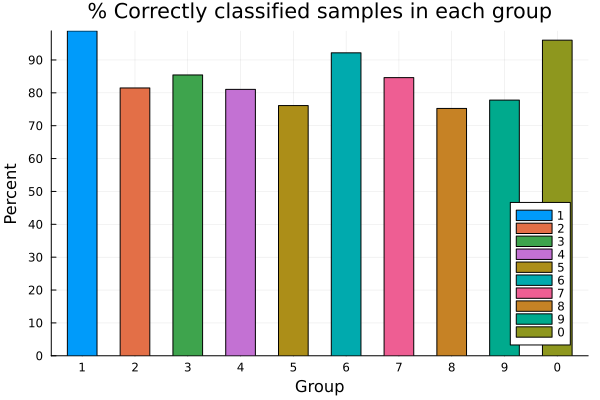

In [17]:
labs = reshape(string.(rem.(1:ng,ng)), 1,ng) # Class labels (1,2,3,...,9,0)
# display(bar(labs, diag(pCMpr)', label = labs, title = "% Correctly classified samples in each group", xlabel = "Group", ylabel = "Percent"))
display(bar(labs, diag(pCMpr)', label = labs, title = "% Correctly classified samples in each group", xlabel = "Group", ylabel = "Percent", yticks = 0:10:100))

Now using additional R-features

In [19]:
nrf  = 500;  # = 5000 (6000)     # The number of random features to be generated.
R    = 2.0*bitrand(n,nrf).-1;
R_XtrR = max.(Xtrain*R,0);
R_XTeR = max.(Xtest*R,0);
XtrR = [Xtrain R_XtrR];
XteR = [Xtest  R_XTeR];

In [20]:
clusterR_labels = Int.(assign_labels(XtrR, Gtrain, ng));

Iteration 1: Jclust = 4410.315063179986.
Iteration 2: Jclust = 

3206.128448836552.
Iteration 3: Jclust = 3140.266545255164.


Iteration 4: Jclust = 3022.300702491366.


Iteration 5: Jclust = 2932.8445674832647.


Iteration 6: Jclust = 2898.9769376493946.


Iteration 7: Jclust = 2885.455010731583.


Iteration 8: Jclust = 2878.1715858404855.


Iteration 9: Jclust = 2873.983787361759.


Iteration 10: Jclust = 2871.4065948689713.


Iteration 11: Jclust = 2869.575439267058.


Iteration 12: Jclust = 2868.4520464850298.


Iteration 13: Jclust = 2867.849964349572.


Iteration 14: Jclust = 2867.398694059902.


Iteration 15: Jclust = 2867.0615999059946.


Iteration 16: Jclust = 2866.8697245869325.


Iteration 17: Jclust = 2866.735482062961.


Iteration 18: Jclust = 2866.624769071353.


Iteration 19: Jclust = 2866.550993437541.


Iteration 20: Jclust = 2866.524299406237.


Iteration 1: Jclust = 10288.613758488114.


Iteration 2: Jclust = 9209.405229219117.


Iteration 3: Jclust = 9158.02353145672.


Iteration 4: Jclust = 9147.81295137658.


Iteration 5: Jclust = 9142.742897872944.


Iteration 6: Jclust = 9139.829073449971.


Iteration 7: Jclust = 9137.712239608958.


Iteration 8: Jclust = 9136.65043985395.


Iteration 9: Jclust = 9136.117198470458.


Iteration 10: Jclust = 9135.8765152908.


Iteration 11: Jclust = 9135.791406674602.


Iteration 1: Jclust = 9169.710269287665.


Iteration 2: Jclust = 8386.549648955297.


Iteration 3: Jclust = 8172.04321432105.


Iteration 4: Jclust = 8079.848296996652.


Iteration 5: Jclust = 8048.981892793187.


Iteration 6: Jclust = 8034.125751399353.


Iteration 7: Jclust = 8019.462860942013.


Iteration 8: Jclust = 8006.576108264534.


Iteration 9: Jclust = 7996.345369936587.


Iteration 10: Jclust = 7988.0868501515315.


Iteration 11: Jclust = 7983.351971367221.


Iteration 12: Jclust = 7980.796591324818.


Iteration 13: Jclust = 7978.980491243327.


Iteration 14: Jclust = 7977.5692528250665.


Iteration 15: Jclust = 7976.754332350748.


Iteration 16: Jclust = 7976.065320893138.


Iteration 17: Jclust = 7975.789710931437.


Iteration 18: Jclust = 7975.548445839622.


Iteration 19: Jclust = 7975.4225543747925.


Iteration 20: Jclust = 7975.29222229891.


Iteration 21: Jclust = 7975.174725783216.


Iteration 22: Jclust = 7974.986171605243.


Iteration 23: Jclust = 7974.844554339818.


Iteration 24: Jclust = 7974.742866009217.


Iteration 25: Jclust = 7974.6839251987885.


Iteration 1: Jclust = 8156.707015034373.


Iteration 2: Jclust = 7496.803778072428.


Iteration 3: Jclust = 7348.499405219887.


Iteration 4: Jclust = 7276.060508101535.


Iteration 5: Jclust = 7213.009673489065.


Iteration 6: Jclust = 7176.597226767591.


Iteration 7: Jclust = 7160.97829024356.


Iteration 8: Jclust = 7154.92692206016.


Iteration 9: Jclust = 7151.173271846896.


Iteration 10: Jclust = 7148.927192229621.


Iteration 11: Jclust = 7148.132433127628.


Iteration 12: Jclust = 7147.636286369543

.
Iteration 13: Jclust = 7147.21865635856.


Iteration 14: Jclust = 7146.944857164498.


Iteration 15: Jclust = 7146.76938213253.


Iteration 16: Jclust = 7146.662956896479.


Iteration 17: Jclust = 7146.554568620588.


Iteration 18: Jclust = 7146.425048472132.


Iteration 19: Jclust = 7146.343589111686.


Iteration 20: Jclust = 7146.269761517372.


Iteration 21: Jclust = 7146.223168958003.


Iteration 1: Jclust = 9367.933734063501.


Iteration 2: Jclust = 8087.275815057262.


Iteration 3: Jclust = 8001.505647461991.


Iteration 4: Jclust = 7957.858163579997.


Iteration 5: Jclust = 7936.9643734819865.


Iteration 6: Jclust = 7927.530642940855.


Iteration 7: Jclust = 7923.697058657502.


Iteration 8: Jclust = 7922.526537035743.


Iteration 9: Jclust = 7921.999093950862.


Iteration 10: Jclust = 7921.660689694326.


Iteration 11: Jclust = 7921.4618716908735.


Iteration 12: Jclust = 7921.344931304161.


Iteration 13: Jclust = 7921.245527758234.


Iteration 14: Jclust = 7921.101884745766.


Iteration 15: Jclust = 7921.06040438007.


Iteration 1: Jclust = 8636.251423677773.


Iteration 2: Jclust = 7614.501566303526.


Iteration 3: Jclust = 7430.842118887616.


Iteration 4: Jclust = 7372.8250595181225.


Iteration 5: Jclust = 7345.544879977253.


Iteration 6: Jclust = 7328.663450107926.


Iteration 7: Jclust = 7314.3964183588905.


Iteration 8: Jclust = 7304.454426529678.


Iteration 9: Jclust = 7298.263034339172.


Iteration 10: Jclust = 7294.450166063123.


Iteration 11: Jclust = 7291.8434209543275.


Iteration 12: Jclust = 7289.531145276673.


Iteration 13: Jclust = 7287.865630363458.


Iteration 14: Jclust = 7286.661943151319.


Iteration 15: Jclust = 7285.558549870601.


Iteration 16: Jclust = 7284.609915622588.


Iteration 17: Jclust = 7283.762806879004.


Iteration 18: Jclust = 7282.663068042122.


Iteration 19: Jclust = 7281.128070761446.


Iteration 20: Jclust = 7279.754744121699.


Iteration 21: Jclust = 7278.738482894213.


Iteration 22: Jclust = 7277.817870907842.


Iteration 23: Jclust = 7277.046688224907.


Iteration 24: Jclust = 7276.44720441748.


Iteration 25: Jclust = 7275.691925511199.


Iteration 26: Jclust = 7274.833930437952.


Iteration 27: Jclust = 7274.149355469869.


Iteration 28: Jclust = 7273.616493098513.


Iteration 29: Jclust = 7273.013749173572.


Iteration 30: Jclust = 7272.518639281651.


Iteration 31: Jclust = 7272.2055138930145.


Iteration 32: Jclust = 7272.083199897606.


Iteration 33: Jclust = 7272.038573161963.


Iteration 1: Jclust = 7722.93875124157.


Iteration 2: Jclust = 6699.9979792892955.


Iteration 3: Jclust = 6630.354872755116.


Iteration 4: Jclust = 6616.750635541027.


Iteration 5: Jclust = 6610.034161652389.


Iteration 6: Jclust = 6602.229148266469.


Iteration 7: Jclust = 6590.171472079852.


Iteration 8: Jclust = 6574.871029837411.


Iteration 9: Jclust = 6557.803486086819.


Iteration 10: Jclust = 6539.469814170758.


Iteration 11: Jclust = 6524.519618696115.


Iteration 12: Jclust = 6513.103307467504.


Iteration 13: Jclust = 6501.8069814104.


Iteration 14: Jclust = 6492.645932281335.


Iteration 15: Jclust = 6486.300402790419.


Iteration 16: Jclust = 6481.843206715467.


Iteration 17: Jclust = 6478.893489663897.


Iteration 18: Jclust = 6477.4076351471085.


Iteration 19: Jclust = 6476.3187375338475.


Iteration 20: Jclust = 6475.692737246896.


Iteration 21: Jclust = 6475.272020903295.


Iteration 22: Jclust = 6474.808842019874.


Iteration 23: Jclust = 6474.521220227045.


Iteration 24: Jclust = 6474.426646429572.
Iteration 

25: Jclust = 6474.343431599494.


Iteration 26: Jclust = 6474.3138644637775.


Iteration 1: Jclust = 9181.252280860117.


Iteration 2: Jclust = 8561.994999528839.


Iteration 3: Jclust = 8391.119300181168.


Iteration 4: Jclust = 8296.293495898146.


Iteration 5: Jclust = 8206.567080306166.


Iteration 6: Jclust = 8123.789379976829.


Iteration 7: Jclust = 8070.52047757364.


Iteration 8: Jclust = 8042.7770361778075.


Iteration 9: Jclust = 8028.08159476252.


Iteration 10: Jclust = 8020.173589058621.


Iteration 11: Jclust = 8014.263402792983.


Iteration 12: Jclust = 8010.756129127141.


Iteration 13: Jclust = 8008.902346695313.


Iteration 14: Jclust = 8007.670399338099.


Iteration 15: Jclust = 8006.877819151024.


Iteration 16: Jclust = 8006.227609693947.


Iteration 17: Jclust = 8005.821234979309.


Iteration 18: Jclust = 8005.562020388495.


Iteration 19: Jclust = 8005.429655643755.


Iteration 20: Jclust = 8005.380179973886.


Iteration 1: Jclust = 7863.82633700602.


Iteration 2: Jclust = 6879.069872626813.


Iteration 3: Jclust = 6694.686882088859.


Iteration 4: Jclust = 6622.712382683083.


Iteration 5: Jclust = 6602.070566440048.


Iteration 6: Jclust = 6594.331788949201.


Iteration 7: Jclust = 6591.575301074987.


Iteration 8: Jclust = 6590.124145332138.


Iteration 9: Jclust = 6589.051146843801.


Iteration 10: Jclust = 6588.17298896376.


Iteration 11: Jclust = 6587.553753280381.


Iteration 12: Jclust = 6587.0751013440795.


Iteration 13: Jclust = 6586.648611861335.


Iteration 14: Jclust = 6586.421450574151.


Iteration 15: Jclust = 6586.320281570401.


Iteration 16: Jclust = 6586.2741598843295.


Iteration 1: Jclust = 10745.99486248052.


Iteration 2: Jclust = 9440.231075441185.


Iteration 3: Jclust = 9373.540857521137.


Iteration 4: Jclust = 9313.360433075452.


Iteration 5: Jclust = 9218.474627610207.


Iteration 6: Jclust = 9103.966132966187.


Iteration 7: Jclust = 9015.828330604836.


Iteration 8: Jclust = 8973.233737958522.


Iteration 9: Jclust = 8952.405946888412.


Iteration 10: Jclust = 8940.67762445255.


Iteration 11: Jclust = 8934.431377076728.


Iteration 12: Jclust = 8930.81996246424.


Iteration 13: Jclust = 8927.334097699502.


Iteration 14: Jclust = 8924.026796303126.


Iteration 15: Jclust = 8920.25577441712.


Iteration 16: Jclust = 8916.261733436191.


Iteration 17: Jclust = 8912.968361695983.


Iteration 18: Jclust = 8910.436273737361.


Iteration 19: Jclust = 8908.289984067764.


Iteration 20: Jclust = 8906.566142767892.


Iteration 21: Jclust = 8905.262656589546.


Iteration 22: Jclust = 8903.528531103937.


Iteration 23: Jclust = 8902.406252052977.


Iteration 24: Jclust = 8901.624776451015.


Iteration 25: Jclust = 8900.938358846795.


Iteration 26: Jclust = 8900.266261086992.


Iteration 27: Jclust = 8899.718252146966.


Iteration 28: Jclust = 8899.19136496443.


Iteration 29: Jclust = 8898.506916263632.


Iteration 30: Jclust = 8897.72281712207.


Iteration 31: Jclust = 8897.014571320651.


Iteration 32: Jclust = 8896.430189997716.


Iteration 33: Jclust = 8896.024225068422.


Iteration 34: Jclust = 8895.763367061212.


Iteration 35: Jclust = 8895.553833438598.


Iteration 36: Jclust = 8895.415583972934.


Iteration 37: Jclust = 8895.291493286984.


Iteration 38: Jclust = 8895.234643719768.


In [21]:
one_hot_encR = OneHotEncoder(clusterR_labels);

In [23]:
λₛ = 10 .^(range(-2 , 10,length = 101))';
@time press, minid, U, σ, V, H, bcoefs, λ, bλ, hλ = TregsYLooCV(XtrR, one_hot_encR, λₛ);

 46.636826 seconds (1.36 k allocations: 5.832 GiB, 1.26% gc time)


In [24]:
# Predict on the training data
n_labels = length(unique(clusterR_labels))
Yhat_R = zeros(m, n_labels); YhatCV_R = zeros(m, n_labels);
for k = 1:n_labels
    Yhat_R[:,k]   = bλ[k][1] .+ XtrR*bλ[k][2:end]; # The fitted values.
    YhatCV_R[:,k] = (Yhat_R[:,k] - hλ[k].*one_hot_encR[:,k])./(1 .-hλ[k]); # The CV predictions.
end

Ghat_R   = getindex.(argmax(Yhat_R, dims=2),2);
GhatCV_R = getindex.(argmax(YhatCV_R, dims=2),2);

In [25]:
# Generate confusion-matrices for the training data classifications:
CMTr = zeros(Int, n_labels, n_labels); CMcv = zeros(Int, n_labels, n_labels);
for k = 1:length(clusterR_labels)
    CMTr[clusterR_labels[k], Ghat_R[k]] += 1; CMcv[clusterR_labels[k], GhatCV_R[k]] += 1;
end

pCMTr = 100*float(CMTr)./float(sum(CMTr, dims = 2));
pCMcv = 100*float(CMcv)./float(sum(CMcv, dims = 2));
pCorrectTr = 100*sum(diag(CMTr))/m # % correct classifications of traning-data
pCorrectCV = 100*sum(diag(CMcv))/m # % crossvalidated correct classifications

println(pCorrectTr,"   ", pCorrectCV)
CMTr

86.67833333333333   85.11833333333334


30×30 Matrix{Int64}:
 1650     0    39     2     6     1  …     0     0     0     0     0     1
    0  2372    41     5     6     1        1     0     2     0     0     0
   12    28  2488     5    11     0        0     0     0     0     0     0
    0     0     0  1462   117    54        0     2     0     1     0     4
   16    19    28   303  1461   170        3     7     3     2     7    24
    0     0     1    27    38  1828  …     0     0     0     4    11     8
    0     0     0    13     2     3        0     0     1     3     0     5
    0    15    12     1    29     1        9    14    16     0     1     2
    0     0     0     2     8    28        7     2     2     1     7     5
    0     0     0     1     5     6        1    21     4     2     1     0
    ⋮                             ⋮  ⋱           ⋮                    
    7     0     3     0     4    13       25     1     1     1     8     2
    6    28    29     0    15     3        8     5    18     1     0    12
    0   

In [26]:
# % Correct classifications on training data when mapping to original labels
map2orig(Gpred) = div.((Gpred .+ 2), 3)
Ghat_map_R = map2orig(Ghat_R);
GhatCV_map_R = map2orig(GhatCV_R);

println(sum(Ghat_map_R .== Gtrain)/m)
println(sum(GhatCV_map_R .== Gtrain)/m)

0.9306166666666666
0.9231


In [27]:
# Compute predictions (Ypred) on the test-data:
Ypred_R = zeros(mte, n_labels);
for k = 1:n_labels
    Ypred_R[:,k] = bλ[k][1].+ XteR*bλ[k][2:end]; # The testset predictions
end

# The resulting predicted groups:
Gpred_R = getindex.(argmax(Ypred_R, dims=2),2);
Gpred_R_map = map2orig(Gpred_R); # Map the predicted labels to the original 10 labels
sum(Gpred_R_map .== Gtest)/mte # % correct classifications of test-data

0.9245

In [28]:
# Generate confusion-matrix for the test-data classifications when mapping to original labels:
CMpr_R = zeros(Int, ng, ng);
for k = 1:length(Gtest)
    CMpr_R[Gtest[k], Gpred_R_map[k]] += 1;
end
pCMpr_R = 100*float(CMpr_R)./float(sum(CMpr_R,dims = 2));
pCorrectPred = 100*sum(diag(CMpr_R))/mte # % correct classifications of test-data

pCMpr_R

10×10 Matrix{Float64}:
 98.7665     0.264317   0.264317  …   0.176211    0.0        0.0
  0.872093  90.0194     1.74419       3.00388     0.193798   1.06589
  0.0        1.48515   91.1881        1.9802      0.693069   0.29703
  1.222      0.305499   0.0           0.610998    2.95316    0.101833
  0.112108   0.336323   3.36323       1.56951     0.672646   1.23318
  0.313152   0.417537   0.0       …   0.104384    0.104384   1.14823
  1.84825    1.55642    0.291829      0.0972763   3.50195    0.0
  0.410678   0.718686   2.25873      87.6797      1.02669    1.12936
  0.693756   0.396432   1.09019       0.792864   88.0079     0.594648
  0.102041   0.0        0.306122      0.204082    0.0       98.1633

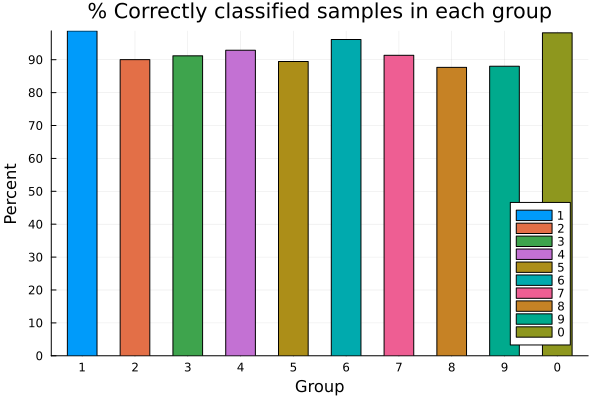

In [30]:
labs = reshape(string.(rem.(1:ng,ng)), 1,ng) # Class labels (1,2,3,...,9,0)
display(bar(labs, diag(pCMpr_R)', label = labs, title = "% Correctly classified samples in each group", xlabel = "Group", ylabel = "Percent", yticks = 0:10:100))

In [34]:
using DataFrames

clf30_10 = DataFrame(
    _30➡10 = ["No extra features", "500 extra R-features"],
    Test_accuracy = [sum(Gpred_map .== Gtest)/mte, sum(Gpred_R_map .== Gtest)/mte]
)

clf30_10

Row,_30➡10,Test_accuracy
,String,Float64
1,No extra features,0.8513
2,500 extra R-features,0.9245


# Tensor compression
The [sugar data](http://models.life.ku.dk/Sugar_Process) (sugar.mat) is in MATLAB format and contains excitation-emission fluorescence (EEF) spectra recorded at different time points. There is one matrix/tensor slice per sample which is best visualized using ``surface()`` (or equivalent) to produce an EEF landscape.

### Exercise 5 - exploratory
Use the ``matread()`` function as before (recall reading the spectra-data) to read the dataset. 
- Reshape the matrix X to a tensor A of size $268 \times 571 \times 7$  (samples, emission, excitation).
- Extract the response y (columns: Date, Color, Ash).
- Extract the wavelengths of the emissions (EmAx) and excitations (ExAx) for use in plotting.
  
Finally 
 - Select a few samples and plot their EEF landscapes by using the _surface_-function in Julia. Try to find some alternatives that do not look too similar.

In [35]:
# Read data using MAT package
# Extract X and y as X and Y
# Reshape X into A
# Extract ExAx and EmAx as excitations and emissions

# using Pkg
# Pkg.add(url="https://github.com/JuliaIO/MAT.jl")
using MAT

# http://models.life.ku.dk/Sugar_Process
vars = matread("sugar.mat") 
X = vars["X"]; Y = vars["y"]; # Date, Color, Ash
A = reshape(X, (268, 571, 7));
excitations = vars["ExAx"][1,:];
emissions = vars["EmAx"][1,:];

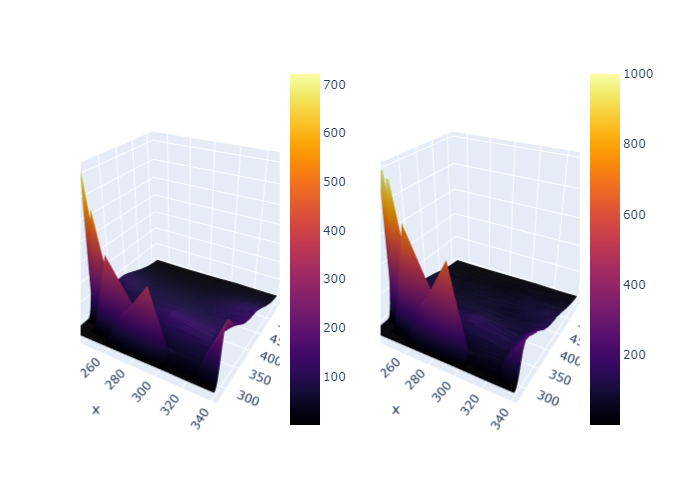

In [57]:
# Make surface plots with "excitations", "emissions" and slices of A
# (A[k,:,:]) for various choices of k.
using Plots
plotlyjs()
plot(surface(excitations, emissions, A[1,:,:]), surface(excitations, emissions, A[160,:,:]))

### Exercise 6 - compression
Perform the HOSVD on the tensor A.
- Plot scores (from U1) as circles/points in 2D and 3D (use ``plotlyjs()`` so you can rotate the 3D plot), colored by one of the responses.
- Plot the first three loadings for the two spectral dimensions as spectra/line plots.
- Use one component from the sample direction and 2/5/all spectral components (excitation and emission), make surface plots of the EEF landscapes and compare with the raw data (flip signs of the results if needed to match the raw data better).

In [38]:
U1,U2,U3,S,s1,s2,s3 = svd3(A);

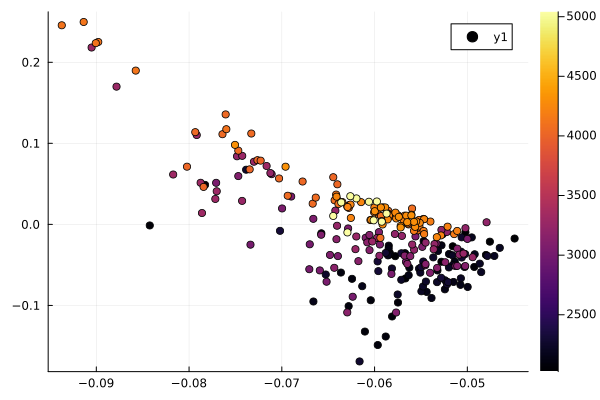

In [54]:
gr()
scatter(U1[:, 1], U1[:, 2], marker_z=Y[:,1])

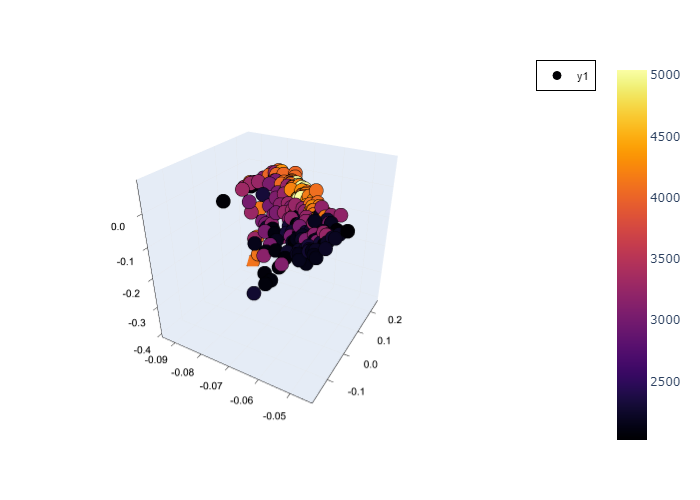

In [64]:
plotlyjs()
scatter(U1[:, 1], U1[:, 2], U1[:, 3], marker_z=Y[:, 1])

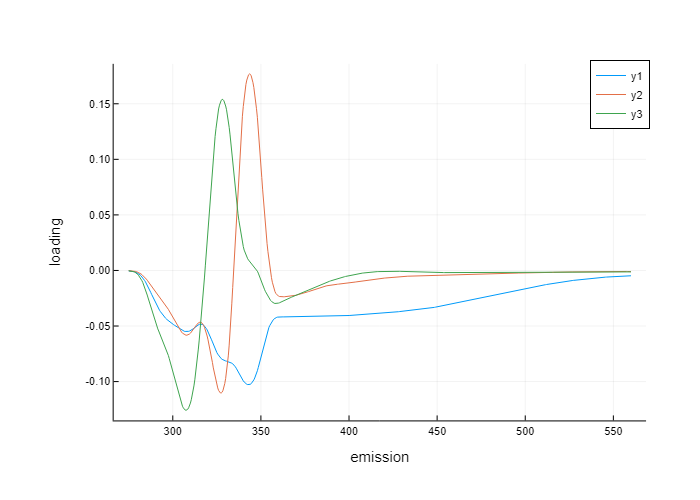

In [44]:
# plot "emissions" vs the first three columns of U2
plot(emissions, U2[:, 1:3], xlabel="emission", ylabel="loading")

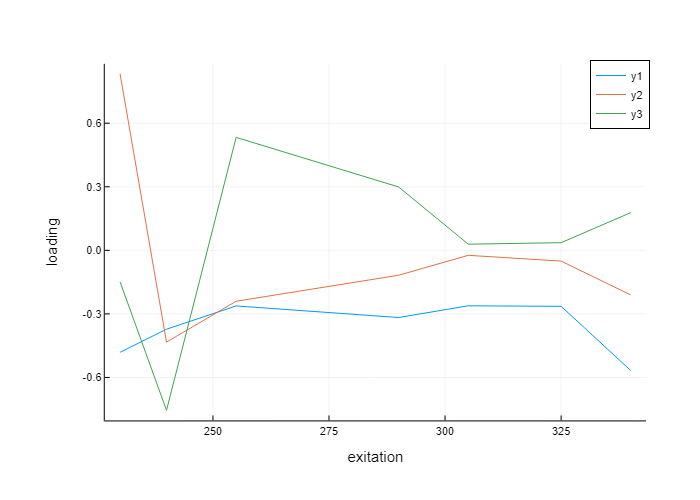

In [46]:
# plot "excitations" vs the first three columns of U3
plot(excitations, U3[:, 1:3], xlabel="exitation", ylabel="loading")

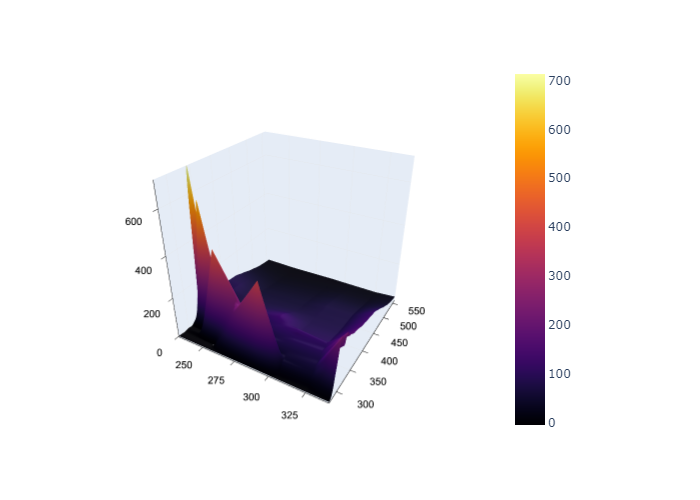

In [65]:
# Make the surface plots of "excitations" vs "emissions" vs the alternative tensor approximations
c = 5;
plotlyjs()
surface(excitations, emissions, Tmul(Tmul(Tmul(S[1:1,1:c,1:c], U1[1, :], 1), U2[:, 1:c], 2), U3[:, 1:c], 3)[1,:,:])



### Exercise 7 - regression
Perform principal component regression (PCR) with 10-fold cross-validation (consecutive segments 1,1,1,..,2,2,2,..,..,10,10) using components from the __matrix X__ and the Color response from y. Plot the RMSEP (based on the cross validation predictions) for up to 10 components.  
  
What, if anything, would be the difference if the PCR was based on components (U1) from the HOSVD of A instead?

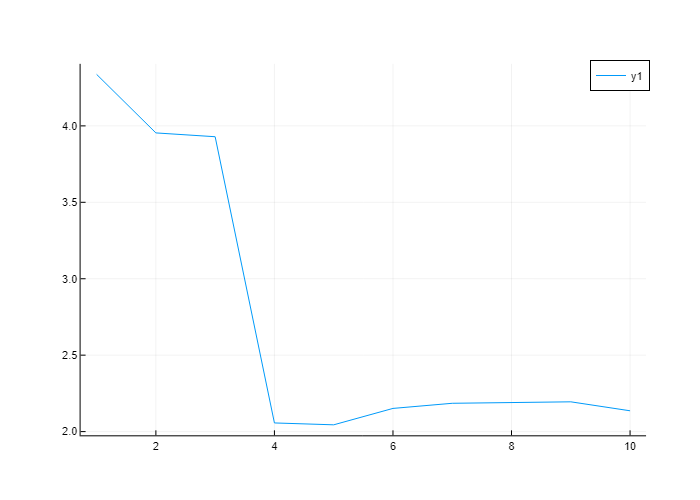

In [49]:
# Prepare cross-validation segment vector, storage of predictions and set the number of components
# Perform cross-validation loop to calculate the PCR predictions
# Plot the resulting RMSEP curve
cv = sort(repeat(1:10,27)[1:268]);
ncomp = 10;
ŷₓ = zeros((268,10));
for a=1:10
    β₀, B = PCRk(X[cv .!= a,:], Y[cv .!= a ,2]; k = ncomp);
    ŷₓ[cv .== a,:] = X[cv .== a,:]*B .+ β₀
end
plot(sqrt.(sum((Y[:,2] .- ŷₓ).^2, dims=1)./268)[1,:])

---------------- SOLUTION ----------------  
When reshaping $X$ to $A$ the feature representation may be shifted. When decomposing $A$ by HOSVD, $U1$ may now capture different aspects of the data. Also the dimensions are reduced in $U1$ and is easier to work with.

# Mayonnaise NIR spectra
A dataset of Near-Infrared (NIR) spectroscopy of [Mayonnaise](https://doi.org/10.1016/S0169-7439(99)00023-4) contains 120+42 samples (training+testset) with 351 wavelengths. The spectra are associated with a discrete response of six oil types and a mixture design (both contained in the response matrices). Wavelengths range from 1100 nm to 2500 nm in steps of 4 nm.

### Exercise 8 - exploratory
Use the ``matread()`` function as earlier to read the dataset, then plot the spectra in the "Xtrain"-matrix.

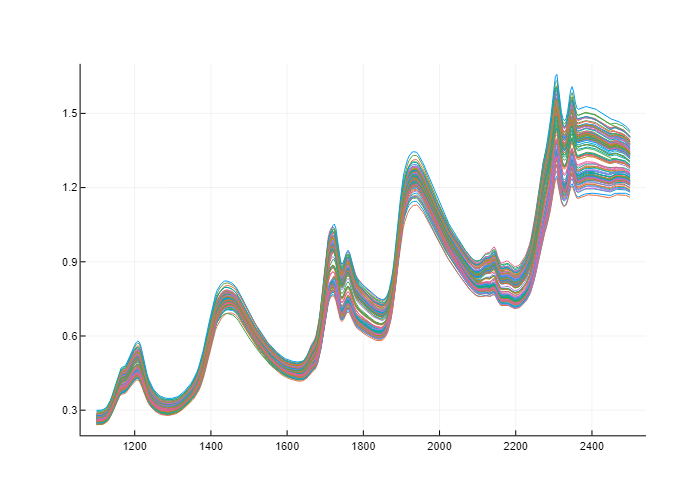

In [50]:
# Read Xtrain, Ytrain, Xtest and Ytest from mayonnaise.mat
# "plot" wavelengths vs Xtrain

vars = matread("mayonnaise.mat")
vars
Xtrain = vars["Xtrain"]; Ytrain = vars["Ytrain"];
Xtest = vars["Xtest"]; Ytest = vars["Ytest"];

using Plots
plot((1100:4:2500), Xtrain', label="")

### Exercise 9 - Variable selection + Classification
Perform Principal Variable Selection (PVS) on the NIR data and use up to 10 variables together with a Linear Discriminant Analysis to classify the oil types in the test set. Plot the proportion of misclassified samples in the test set.  
  
Note: The response is coded as float, but for LDA you need an integer coded response. This can be converted using the function ``Int.()``.

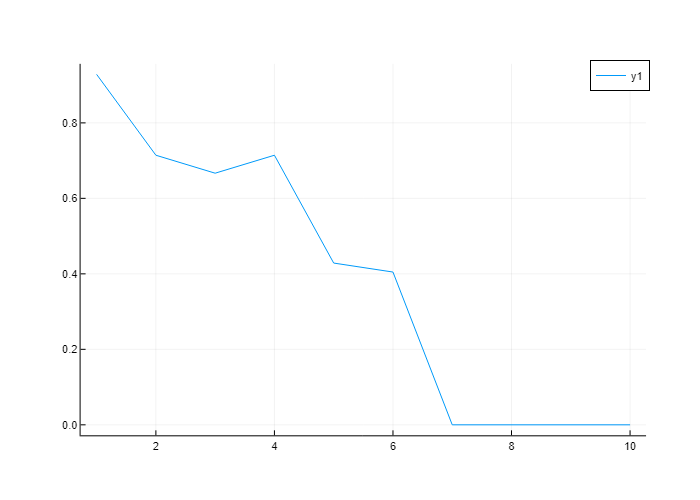

In [51]:
# Perform "pvs" on Xtrain
# Loop over 1:10 variables
    # Perform LDA with selected variables and predict Xtest with the same variables selected
# Plot the proportion of Ytest samples that have a different class than predicted

nvar = 10;
Q, R, ids, vperm, ssEX, ni, U, σ = pvs(Xtrain, nvar);
Ŷ = zeros((42, nvar));
for i=1:nvar
    Ŷ[:, i] = lda(Xtrain[:, ids[1:i]], Int.(Ytrain[:, 1]), Xtest[:, ids[1:i]]);
end
plot(sum(Int.(Ytest[:,1]) .!= Ŷ, dims=1)[1,:]./42)